In [ ]:
"""installs"""

# !pip install nc-time-axis
# !pip install netCDF4 h5netcdf
# !pip install xarray
# !pip install cdsapi
# !pip install networkx geopandas osmnx igraph matplotlib


'installs'

## Main imports & definitions

In [ ]:
"""
winter_tr -- это должно быть зимники?
"""

KELVIN_TO_CELSIUS = 273.15


In [ ]:
import networkx as nx
import pandas as pd
import geopandas as gpd

transport_modes = [
    "car_warm",
    "plane",
    "water_ship",
    "water_boat",
    "car_cold",
    "winter_tr",
]
# period = "warm"
SETTL_NAME = "nao"
CRS = 4326


In [ ]:
main_data_path = "/Users/test/Documents/code/iccs25/initial_data/Арктика/"


In [ ]:
settl = gpd.read_file(f"df_settlements_{SETTL_NAME}.geojson").to_crs(CRS)
# settl.explore()


In [ ]:
transport_df = (
    gpd.read_file(f"df_time_{SETTL_NAME}.geojson")
    .to_crs(CRS)
    .dropna(subset=["geometry"])
)


In [ ]:
transport_df


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry
0,Андег,Куя,0.0,0.0,0.75,0.75,0.0,0.0,45,True,False,"LINESTRING (53.22094 67.89129, 53.26 67.77112)"
1,Андег,Нельмин-Нос,0.0,0.9800000190734863,0.8299999833106995,0.8299999833106995,0.0,0.0,53,True,False,"LINESTRING (52.95752 67.97979, 53.21956 67.89129)"
2,Архангельск,Индига,0.0,4.0,0.0,0.0,0.0,0.0,240,False,False,"LINESTRING (49.03239 67.65581, 40.50149 64.54982)"
3,Архангельск,Мезень,7.0,0.9200000166893005,0.0,0.0,7.0,0.0,298,False,False,"LINESTRING (44.24498 65.85058, 40.56323 64.55786)"
4,Архангельск,Нарьян-Мар,46.0,1.25,0.0,0.0,46.0,0.0,1865,False,False,"LINESTRING (52.99945 67.63909, 40.52487 64.54379)"
...,...,...,...,...,...,...,...,...,...,...,...,...
121,Харута,Хорей-Вер,0.0,0.6299999952316284,0.0,0.0,0.0,0.0,38,False,False,"LINESTRING (59.53631 66.83876, 58.04778 67.42212)"
122,Хонгурей,Каменка,0.5,0.0,0.0,0.0,0.0,1.0,45,False,True,"LINESTRING (51.95409 67.55806, 51.88306 67.48809)"
123,Чижа,Индига,0.0,1.2899999618530273,0.0,0.0,0.0,0.0,77,False,False,"LINESTRING (44.38303 67.08776, 49.02904 67.65581)"
124,Шойна,Чижа,0.0,0.4399999976158142,0.0,0.0,0.0,0.0,26,False,False,"LINESTRING (44.15306 67.87874, 44.38352 67.08784)"


## Data reading & preprocessing

In [ ]:
msk = transport_df["geometry"].isna()
transport_df[msk]


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry


In [ ]:
transport_df[transport_df["edge1"] == "Волоковая"]


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry
20,Волоковая,Верхняя Пеша,0.5699999928474426,0.1899999976158142,0.0,0.0,0.0,1.14,38,False,True,"LINESTRING (48.24391 66.48315, 47.96304 66.60943)"
21,Волоковая,Волонга,0.0,0.3799999952316284,0.0,0.0,0.0,0.00,23,False,False,"LINESTRING (47.77519 67.13186, 48.24298 66.48379)"


In [ ]:
transport_df.explore()


In [ ]:
infr_df = pd.read_csv(f"infrastructure_data/infrastructure_{SETTL_NAME}.csv", sep=";")


In [ ]:
settl["name"] = settl["name"].str.replace("ё", "е")


In [ ]:
# Convert mode values from ',' to '.' and ensure they are float
for mode in transport_modes:
    transport_df[mode] = (
        transport_df[mode].astype(str).str.replace(",", ".").astype(float)
    )

# Fill NaNs with 0
infr_df.fillna(0, inplace=True)


In [ ]:
for t in transport_modes:
    transport_df[t] = transport_df[t].astype(str).str.replace(",", ".").astype(float)


In [ ]:
transport_df.head(2)


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry
0,Андег,Куя,0.0,0.00,0.75,0.75,0.0,0.0,45,True,False,"LINESTRING (53.22094 67.89129, 53.26 67.77112)"
1,Андег,Нельмин-Нос,0.0,0.98,0.83,0.83,0.0,0.0,53,True,False,"LINESTRING (52.95752 67.97979, 53.21956 67.89129)"


In [ ]:
msk1 = transport_df["car_cold"] == 0
msk2 = transport_df["car_warm"] != 0

transport_df[msk1 & msk2].explore()


In [ ]:
x = transport_df.union_all().centroid.x
y = transport_df.union_all().centroid.y


In [ ]:
import folium
from folium import FeatureGroup
import geopandas as gpd


# Start a base map
m = folium.Map(location=[x, y], zoom_start=5, tiles="cartodbpositron")

# Define transport columns you want to show as layers
transport_cols = [
    "car_warm",
    "plane",
    "water_ship",
    "water_boat",
    "car_cold",
    "winter_tr",
]

# Color palette just for better visibility
colors = ["red", "blue", "green", "purple", "orange", "black"]

# Create a layer for each transport type
for mode, color in zip(transport_cols, colors):
    fg = FeatureGroup(name=mode)

    # Filter edges with non-zero availability for this transport type
    gdf_filtered = transport_df[transport_df[mode] > 0]

    # Add each geometry as a line to the FeatureGroup
    for _, row in gdf_filtered.iterrows():
        folium.PolyLine(
            locations=[(coord[1], coord[0]) for coord in row["geometry"].coords],
            color=color,
            tooltip=f"{row['edge1']} ↔ {row['edge2']} ({mode})",
            weight=3,
        ).add_to(fg)

    fg.add_to(m)


In [ ]:
# import geopandas as gpd
# import folium


# # Create a FeatureGroup for settl
# settl_fg = folium.FeatureGroup(name="Settlements")

# # Add points as markers (or use folium.GeoJson for styling polygons)
# for _, row in settl.iterrows():
#     folium.CircleMarker(
#         location=(row.geometry.y, row.geometry.x),
#         radius=8,
#         popup=row[["name", "airport", "port", "pristan"]].to_dict(),
#         color="darkgreen",
#         fill=True,
#         fill_opacity=0.7,
#     ).add_to(settl_fg)

# settl_fg.add_to(m)

# # Add layer control to toggle layers
# folium.LayerControl().add_to(m)

# m


In [ ]:
transport_df.head(2)


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry
0,Андег,Куя,0.0,0.00,0.75,0.75,0.0,0.0,45,True,False,"LINESTRING (53.22094 67.89129, 53.26 67.77112)"
1,Андег,Нельмин-Нос,0.0,0.98,0.83,0.83,0.0,0.0,53,True,False,"LINESTRING (52.95752 67.97979, 53.21956 67.89129)"


In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np

import scripts.model as model

UTM_CRS = 32639
DEMAND_COL = "demand_without"
SERVICE_NAME = "hospital"
SETTL_NAME = "nao"

df_service = gpd.read_file(f"df_{SERVICE_NAME}_{SETTL_NAME}.geojson").to_crs(UTM_CRS)

# ??????????????????
CONST_BASE_DEMAND = 120  # if not known (!)
SERVICE_RADIUS_MINUTES = 300
df_matrix = model.make_adjacency_matrix(transport_df)
blocks_gdf = model.create_blocks(settl, const_demand=CONST_BASE_DEMAND, epsg=UTM_CRS)
matrix = model.create_graph(df_matrix)
blocks = model.update_blocks_with_services(
    blocks_gdf, df_service, epsg=UTM_CRS, service_type_name=SERVICE_NAME
)
id_matrix = df_matrix.index.tolist()


In [ ]:
settl = settl.join(
    df_service[["name", "capacity"]].set_index("name"),
    on="name",
    rsuffix="_service",
    how="left",
)


In [ ]:
# Convert G to an undirected graph
G_undirected = nx.Graph()

# Add edges from transport_df
for _, row in transport_df.iterrows():
    for mode in transport_modes:
        if row[mode] != 0:
            G_undirected.add_edge(
                row["edge1"],
                row["edge2"],
                weight=round(row[mode], 2),
                label=mode,
            )

# Add node properties from settl dataframe
for _, row in settl.iterrows():
    node = row["name"]
    if node in G_undirected.nodes:
        for col in settl.columns:
            # if col != "geometry":  # Skip geometry column
            G_undirected.nodes[node][col] = row[col]

            if col == "geometry":
                # Convert geometry to WKT format
                geom = row[col]
                if geom is not None:
                    G_undirected.nodes[node]["x"] = geom.centroid.x
                    G_undirected.nodes[node]["y"] = geom.centroid.y
                else:
                    G_undirected.nodes[node]["x"] = None
                    G_undirected.nodes[node]["y"] = None

G_undirected.graph["crs"] = settl.crs.to_wkt()

# Create adjacency matrix
adj_matrix = nx.adjacency_matrix(G_undirected, weight="weight").todense()

# Display adjacency matrix
print(adj_matrix)


[[0.   0.75 0.83 ... 0.   0.   0.  ]
 [0.75 0.   1.67 ... 0.   0.   0.  ]
 [0.83 1.67 0.   ... 0.   0.   0.  ]
 ...
 [0.   0.   0.   ... 0.   0.   0.  ]
 [0.   0.   0.   ... 0.   0.   0.  ]
 [0.   0.   0.   ... 0.   0.   0.  ]]


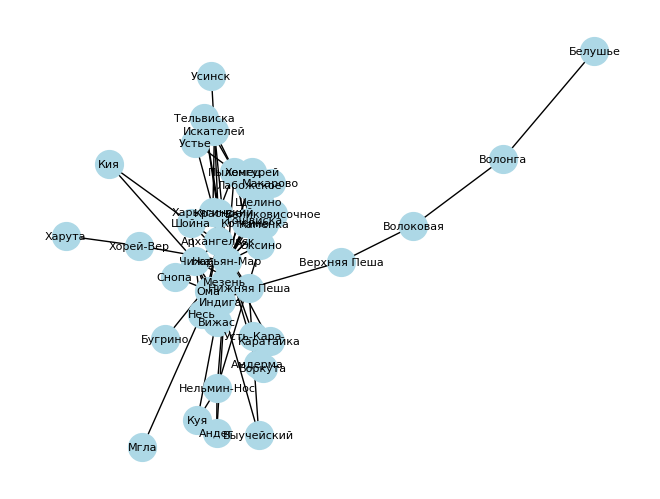

In [ ]:
nx.draw(
    G_undirected, with_labels=True, node_size=400, node_color="lightblue", font_size=8
)


In [ ]:
"""Пример получения годовой температуры помесячно для одного Населенного Пункта"""

# from meteostat import Point, Monthly
# from datetime import datetime

# # Coordinates for Naryan-Mar (capital of NAO)
# lat = 67.6389
# lon = 53.0069

# # Create Point for the location
# location = Point(lat, lon)

# # Get monthly data for the past year
# data = Monthly(location, start=datetime(2024, 1, 1), end=datetime(2024, 12, 31))
# data = data.fetch()

# # Calculate and plot average temperatures
# monthly_temps = data["tavg"].fillna(data["tavg"].median())

# import matplotlib.pyplot as plt

# plt.figure(figsize=(10, 6))
# monthly_temps.plot(kind="bar")
# plt.title("Average Monthly Temperatures in Nenets Autonomous Okrug")
# plt.xlabel("Month")
# plt.ylabel("Temperature (°C)")
# plt.xticks(rotation=45)
# plt.grid(True)
# plt.show()


'Пример получения годовой температуры помесячно для одного Населенного Пункта'

In [ ]:
G_undirected.nodes(data=True)


NodeDataView({'Андег': {'id': 1, 'name': 'Андег', 'population': 175, 'geometry': <POINT (53.221 67.891)>, 'x': 53.220583299999994, 'y': 67.89124249999999, 'capacity': 0}, 'Куя': {'id': 19, 'name': 'Куя', 'population': 152, 'geometry': <POINT (53.26 67.771)>, 'x': 53.2599235, 'y': 67.77130789999998, 'capacity': 0}, 'Нельмин-Нос': {'id': 25, 'name': 'Нельмин-Нос', 'population': 916, 'geometry': <POINT (52.958 67.98)>, 'x': 52.957530999999996, 'y': 67.97980499999998, 'capacity': 0}, 'Архангельск': {'id': 2, 'name': 'Архангельск', 'population': 296665, 'geometry': <POINT (40.54 64.543)>, 'x': 40.53974192744307, 'y': 64.54338332057665, 'capacity': 77021}, 'Индига': {'id': 12, 'name': 'Индига', 'population': 632, 'geometry': <POINT (49.029 67.656)>, 'x': 49.02937299999999, 'y': 67.65588399999999, 'capacity': 0}, 'Мезень': {'id': 23, 'name': 'Мезень', 'population': 2832, 'geometry': <POINT (44.244 65.851)>, 'x': 44.2440715001102, 'y': 65.85093584395014, 'capacity': 600}, 'Нарьян-Мар': {'id': 

## Дата разбита по сетке(?) с шагом 0.5 градуса. Вроде ок для температуры

In [ ]:
import cdsapi

dataset = "projections-cmip6"
request = {
    "temporal_resolution": "monthly",
    "experiment": "ssp5_8_5",
    "variable": "air_temperature",
    "level": ["1000"],
    "model": "inm_cm5_0",
    "year": [
        "2025",
        "2030",
        "2035",
        "2040",
        "2045",
        "2049",
    ],
    "month": ["01", "02", "03", "04", "05", "06", "07", "08", "09", "10", "11", "12"],
    "area": [90, -180, -90, 180],
}

import os

if "unzipped_data" not in os.listdir():
    client = cdsapi.Client()
    client.retrieve(dataset, request).download()


In [ ]:
import zipfile
import os

zip_path = (
    "7d77473eaa89943921e9a26f6f322e7e.zip"  # idk this is random. Change to your own.
)
unzip_folder = "unzipped_data"

with zipfile.ZipFile(zip_path, "r") as zip_ref:
    zip_ref.extractall(unzip_folder)

# Find .nc file
nc_file = None
for file in os.listdir(unzip_folder):
    if file.endswith(".nc"):
        nc_file = os.path.join(unzip_folder, file)
        break

print("Found:", nc_file)

import xarray as xr

ds = xr.open_dataset(nc_file)
print(ds)


Found: unzipped_data/ta_Amon_INM-CM5-0_ssp585_r1i1p1f1_gr1_20250116-20491216.nc
<xarray.Dataset> Size: 7MB
Dimensions:    (time: 72, bnds: 2, plev: 1, lat: 120, lon: 180)
Coordinates:
  * time       (time) object 576B 2025-01-16 12:00:00 ... 2049-12-16 12:00:00
  * plev       (plev) float64 8B 1e+05
  * lat        (lat) float64 960B -89.25 -87.75 -86.25 ... 86.25 87.75 89.25
  * lon        (lon) float64 1kB -178.0 -176.0 -174.0 ... 176.0 178.0 180.0
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) object 1kB ...
    lat_bnds   (time, lat, bnds) float64 138kB ...
    lon_bnds   (time, lon, bnds) float64 207kB ...
    ta         (time, plev, lat, lon) float32 6MB ...
Attributes: (12/47)
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            ScenarioMIP
    branch_method:          standard
    branch_time_in_child:   60225.0
    branch_time_in_parent:  60225.0
    contact:                Evgeny Volodin (volodinev@gmail.com)
    ...         

In [ ]:
def get_season_by_temperature(temp):
    if temp < -10:
        return "winter"
    elif temp > 5:
        return "summer"
    else:
        return "midseason"


for node in G_undirected.nodes:
    if (
        G_undirected.nodes[node]["x"] is not None
        and G_undirected.nodes[node]["y"] is not None
    ):
        lon = G_undirected.nodes[node]["x"]
        lat = G_undirected.nodes[node]["y"]

        # Extract temperature data for the node's coordinates
        city_temp = ds["ta"].sel(lat=lat, lon=lon, method="nearest") - KELVIN_TO_CELSIUS
        G_undirected.nodes[node]["temperature"] = pd.DataFrame(
            city_temp, columns=["temperature"]
        ).round(1)

        G_undirected.nodes[node]["season"] = G_undirected.nodes[node][
            "temperature"
        ].map(get_season_by_temperature)


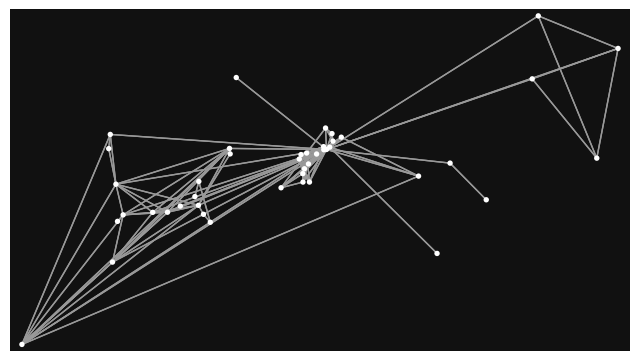

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [ ]:
import osmnx as ox

# ox.save_graphml(nx.MultiDiGraph(G_undirected), "graph.graphml")
ox.plot_graph(nx.MultiDiGraph(G_undirected))


## Let's incorporate Provision Metric


In [ ]:
G_undirected.nodes(data=True)


NodeDataView({'Андег': {'id': 1, 'name': 'Андег', 'population': 175, 'geometry': <POINT (53.221 67.891)>, 'x': 53.220583299999994, 'y': 67.89124249999999, 'capacity': 0, 'temperature':     temperature
0         -18.0
1         -13.8
2          -7.4
3          -3.1
4           4.3
..          ...
67          9.3
68          6.9
69          1.1
70         -4.0
71         -8.8

[72 rows x 1 columns], 'season':    temperature
0       winter
1       winter
2    midseason
3    midseason
4    midseason
..         ...
67      summer
68      summer
69   midseason
70   midseason
71   midseason

[72 rows x 1 columns]}, 'Куя': {'id': 19, 'name': 'Куя', 'population': 152, 'geometry': <POINT (53.26 67.771)>, 'x': 53.2599235, 'y': 67.77130789999998, 'capacity': 0, 'temperature':     temperature
0         -18.0
1         -13.8
2          -7.4
3          -3.1
4           4.3
..          ...
67          9.3
68          6.9
69          1.1
70         -4.0
71         -8.8

[72 rows x 1 columns], 'season':

In [ ]:
# First create a mapping between original names and integers
node_mapping = {name: i for i, name in enumerate(sorted(G_undirected.nodes()))}
inverse_mapping = {i: name for name, i in node_mapping.items()}

# Create new graph with integer nodes
G_int = nx.Graph()

# Add edges with remapped nodes
for u, v, data in G_undirected.edges(data=True):
    G_int.add_edge(node_mapping[u], node_mapping[v], **data)

# Add node attributes
for old_node, data in G_undirected.nodes(data=True):
    new_node = node_mapping[old_node]
    G_int.nodes[new_node].update(data)

G_undirected = G_int


In [ ]:
# Add to imports section
import scripts.provision as provision

# After creating G_undirected, calculate provision
result = provision.calculate_graph_provision(G_undirected)
avg_provision = round(result["provision"].mean(), 2)
print(f"Average provision: {avg_provision}")


Average provision: 0.67


## Ok so to the modelling again...

### Для третьего года (2035) плохие показатели это ок согласно картинкам ниже с графиком изменения температур(ы)

In [ ]:
import networkx as nx
import pandas as pd
import numpy as np


class Statistics:
    def __init__(self):
        self.records = pd.DataFrame(
            columns=[
                "idx",
                "metric",
            ]
        )
        self.graphs = list()

    def add_record(self, step_index, metrics: dict, G):
        new_row = pd.DataFrame(
            [
                {
                    "idx": step_index,
                    "metric": metrics.get("metric"),
                }
            ]
        )
        self.records = pd.concat([self.records, new_row], ignore_index=True)
        self.graphs.append(G)

    def summary(self):
        return self.records.pivot_table(index="idx", columns="col", values="metric")

    def full(self):
        return self.records


def sigmoid(x, center, steepness=1):
    """
    Sigmoid function for smooth probability transition
    center: temperature at which probability is 0.5
    steepness: controls how sharp the transition is
    """
    return 1 / (1 + np.exp(-steepness * (x - center)))


def get_transport_probability(transport_type, temperature):
    """
    Calculate transport probability based on temperature using smooth transitions
    """
    if transport_type == "plane":
        # Planes work better in warmer weather, degrading below -10°C
        return sigmoid(temperature, -5, 0.3)

    elif transport_type in ["water_boat", "water_ship"]:
        # Water transport needs above-freezing temperatures
        return sigmoid(temperature, 0, 0.7)

    elif transport_type == "car_warm":
        # Regular cars work better in warm weather
        return sigmoid(temperature, 10, 0.25)

    elif transport_type in ["car_cold", "winter_tr"]:
        # Winter transport works better in cold weather
        return 1 - sigmoid(temperature, 5, 0.4)

    return 0.0


# Modify the AgglomerationNetwork class to use the new probability function:


class AgglomerationNetwork:
    def __init__(self, graph, threshold):
        self.original_graph = graph.copy()
        self.graph = graph.copy()
        self.threshold = threshold
        self.stats = Statistics()
        self.current_step = 0  # Initialize current_step

    def _get_edge_season(self, G, u, v, idx):
        """
        Определяет сезон ребра (u, v) по самому "холодному" сезону его концов.
        Приоритет: winter > midseason > summer
        """
        priority = {"winter": 0, "midseason": 1, "summer": 2}

        season_u = G.nodes[u].get("season").loc[idx].item()
        season_v = G.nodes[v].get("season").loc[idx].item()

        # print(f"seasons: {season_u}, {season_v}")

        # сравниваем по приоритету
        return min([season_u, season_v], key=lambda s: priority.get(s, float("inf")))

    def assign_edge_seasons(self, G, idx):
        for u, v in G.edges:
            G.edges[u, v]["season"] = self._get_edge_season(G, u, v, idx)

        return G

    def assign_transport_probabilities(self, G):
        """
        Assigns smooth transport probabilities based on temperature
        """
        for u, v, data in G.edges(data=True):
            transport_type = data.get("label")

            # Get average temperature of both endpoints
            temp_u = G.nodes[u]["temperature"].iloc[self.current_step].item()
            temp_v = G.nodes[v]["temperature"].iloc[self.current_step].item()
            avg_temp = (temp_u + temp_v) / 2

            if transport_type:
                prob = get_transport_probability(transport_type, avg_temp)
                data["transport_probability"] = prob
            else:
                data["transport_probability"] = 0.0

    def filter_edges_by_probability(self, G, threshold):
        """
        Возвращает копию графа G, содержащую только те рёбра,
        у которых transport_probability >= threshold
        """
        G_filtered = nx.Graph()
        G_filtered.add_nodes_from(G.nodes(data=True))

        for u, v, data in G.edges(data=True):
            # print(f"edge: {u} - {v}, data: {data}")
            prob = data.get("transport_probability", 0.0)
            if prob >= threshold:
                G_filtered.add_edge(u, v, **data)

        return G_filtered

    def run_all_steps(self, idx):
        self.current_step = idx  # Update current_step
        self.assign_edge_seasons(self.graph, idx)
        self.assign_transport_probabilities(self.graph)
        G_filtered = self.filter_edges_by_probability(
            self.graph, threshold=self.threshold
        )
        result = provision.calculate_graph_provision(G_filtered)
        avg_provision = result["provision"].mean().round(3)
        # print(f"Average provision: {avg_provision}")

        other_metrics = {
            # "avg_connectivity_loss": self.compute_avg_connectivity_loss(G_filtered),
            # "resilience_score": self.compute_resilience_score(G_filtered),
            # "metric": nx.average_node_connectivity(G_filtered),
            "metric": avg_provision,
        }
        metrics = {**other_metrics}

        self.stats.add_record(step_index=idx, metrics=metrics, G=G_filtered)


net = AgglomerationNetwork(graph=G_undirected, threshold=0.9)

range_year = range(12 * 6)
for idx in range_year:
    net.run_all_steps(idx)

df_stats = net.stats.records
df_stats.groupby(df_stats.index // 12).median().iloc[:, -1].round(2)


0    0.46
1    0.46
2    0.46
3    0.46
4    0.46
5    0.46
Name: metric, dtype: float64

## Отрисовка графа

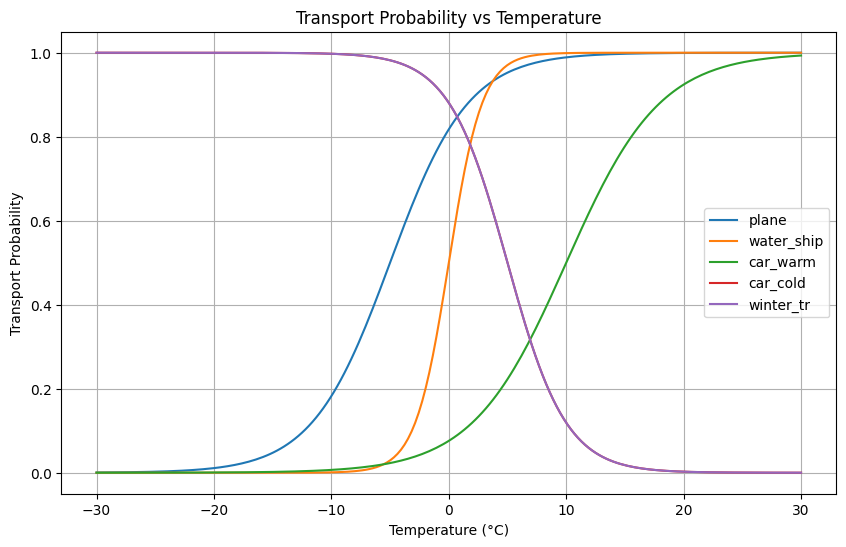

In [ ]:
import matplotlib.pyplot as plt

temps = np.linspace(-30, 30, 200)
transport_types = ["plane", "water_ship", "car_warm", "car_cold", "winter_tr"]

plt.figure(figsize=(10, 6))
for t_type in transport_types:
    probs = [get_transport_probability(t_type, t) for t in temps]
    plt.plot(temps, probs, label=t_type)

plt.xlabel("Temperature (°C)")
plt.ylabel("Transport Probability")
plt.title("Transport Probability vs Temperature")
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
graph_list = net.stats.graphs


In [ ]:
stats_list = net.stats.records["metric"].round(2).tolist()


In [ ]:
result.sort_values(by="provision")


,geometry,demand,capacity,demand_left,demand_within,demand_without,capacity_left,provision
id,,,,,,,,
41,POINT (44.383 67.088),12.0,0.0,12.0,0.0,12.0,0.0,0.000000
18,POINT (53.602 67.834),195.0,0.0,195.0,0.0,195.0,0.0,0.000000
42,POINT (44.153 67.878),36.0,0.0,36.0,0.0,36.0,0.0,0.000000
17,POINT (51.138 67.031),45.0,0.0,45.0,0.0,45.0,0.0,0.000000
38,POINT (56.761 67.216),66.0,0.0,66.0,0.0,66.0,0.0,0.000000
29,POINT (46.495 66.643),92.0,0.0,92.0,0.0,92.0,0.0,0.000000
33,POINT (52.3 67.122),9.0,0.0,9.0,0.0,9.0,0.0,0.000000
35,POINT (64.922 69.244),69.0,0.0,69.0,0.0,69.0,0.0,0.000000
43,POINT (52.034 67.122),13.0,0.0,13.0,0.0,13.0,0.0,0.000000


Кажется где-то баг с существованием ребер и попроговым значением

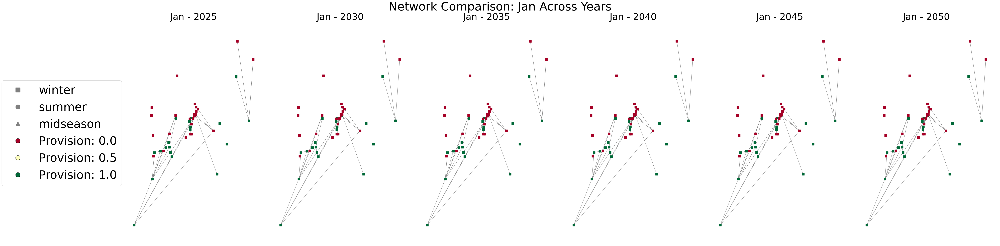

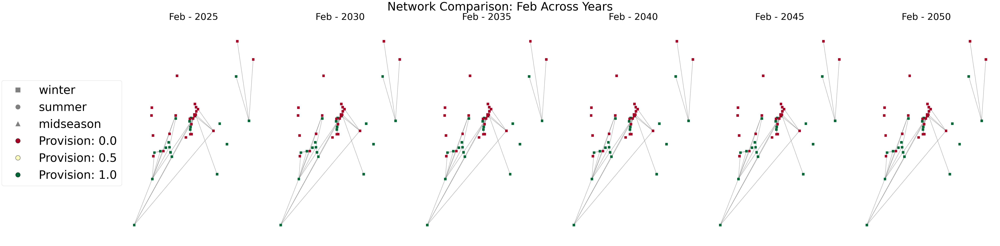

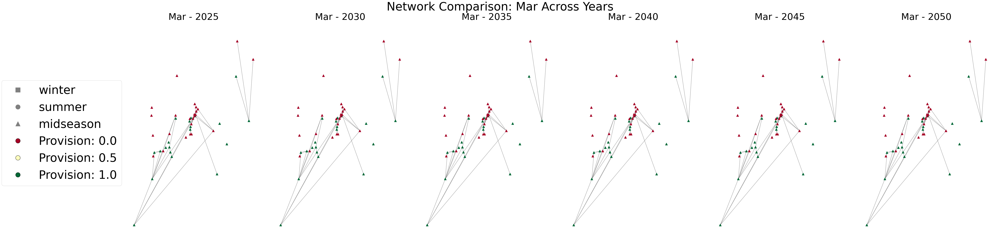

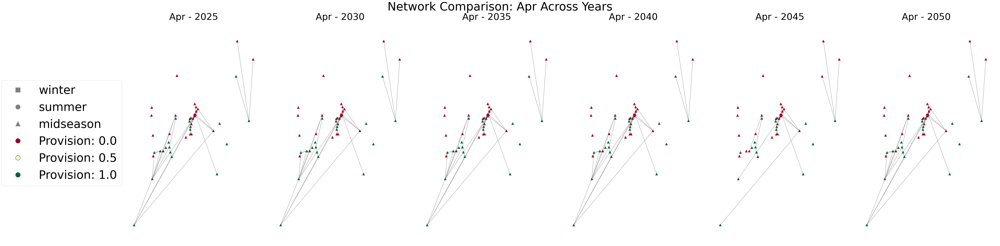

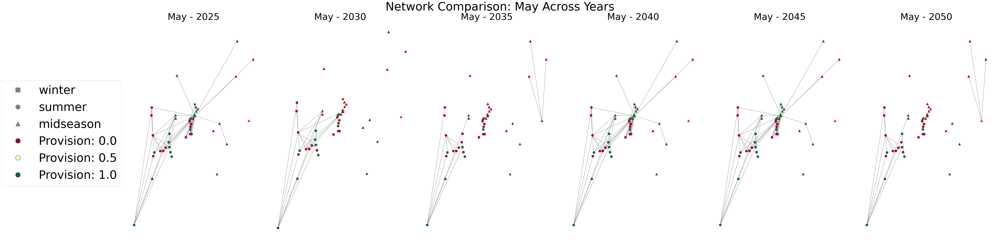

...

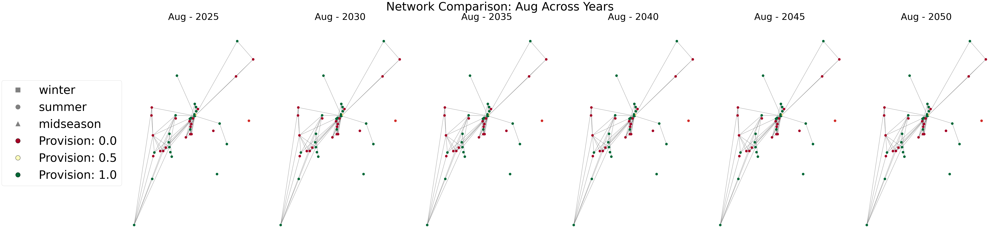

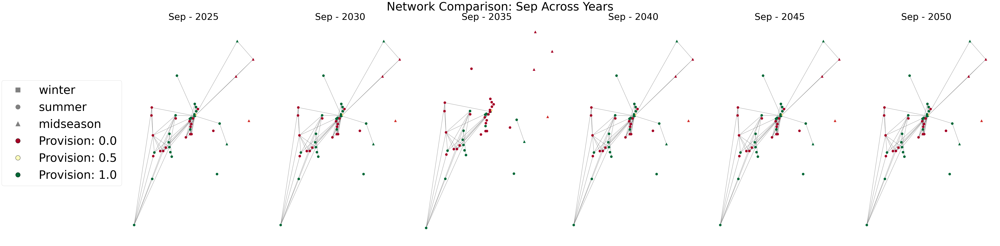

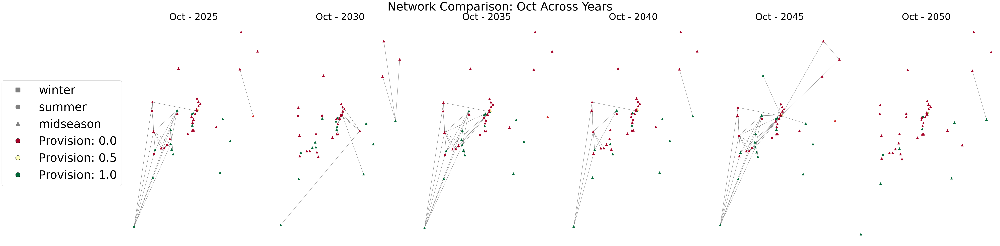

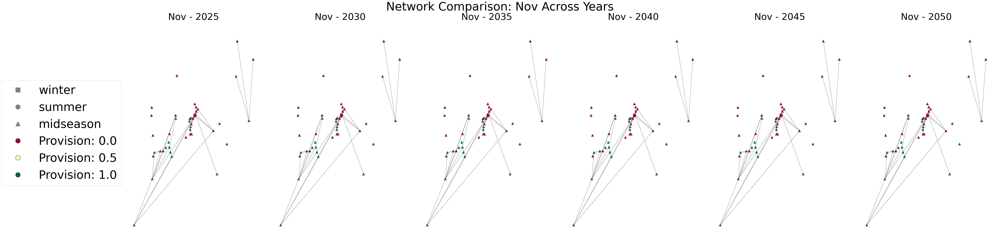

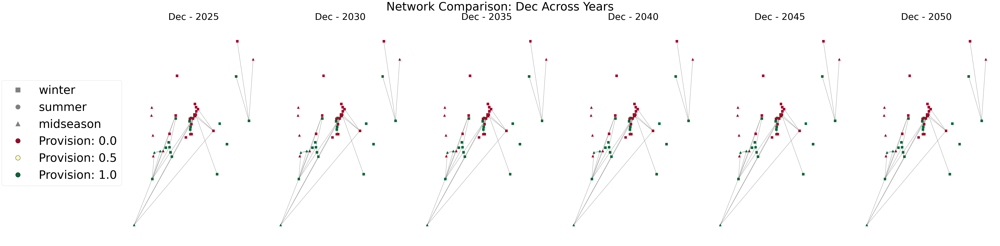

In [ ]:
def plot_colored_graph_by_season_comparison(G, month_idx, graphs, stats):
    """
    Plot comparison of network states for a given month across all years
    """
    fig, axes = plt.subplots(1, len(graphs), figsize=(10 * len(graphs), 15))

    # Handle case of 1 subplot
    if len(graphs) == 1:
        axes = [axes]

    # Get node positions from original graph
    pos = {node: (G.nodes[node]["x"] * 2, G.nodes[node]["y"] * 2) for node in G.nodes()}

    # Shape mapping for seasons
    season_markers = {
        "winter": "s",  # square
        "summer": "o",  # circle
        "midseason": "^",  # triangle
    }

    month_names = [
        "Jan",
        "Feb",
        "Mar",
        "Apr",
        "May",
        "Jun",
        "Jul",
        "Aug",
        "Sep",
        "Oct",
        "Nov",
        "Dec",
    ]

    # Create colormap for provision values
    provision_cmap = plt.cm.RdYlGn  # Red-Yellow-Green colormap

    for i, (year_G, stat) in enumerate(zip(graphs, stats)):
        ax = axes[i]
        ax.set_title(f"{month_names[month_idx]} - {2025 + i*5}", fontsize=40)

        # Calculate provisions
        node_provisions = provision.calculate_graph_provision(year_G)

        # Get node shapes for current timestep
        node_shapes = [
            season_markers[year_G.nodes[node]["season"].iloc[month_idx].item()]
            for node in year_G.nodes()
        ]

        # Use provision values directly with colormap (they're already 0-1)
        provision_values = [
            node_provisions["provision"][node] for node in year_G.nodes()
        ]
        node_colors = provision_cmap(provision_values)

        # Draw edges
        nx.draw_networkx_edges(year_G, pos, edge_color="gray", width=1, ax=ax)

        # Draw nodes for each season separately to maintain different shapes
        for shape in set(node_shapes):
            shape_indices = [i for i, s in enumerate(node_shapes) if s == shape]
            if shape_indices:
                nx.draw_networkx_nodes(
                    year_G,
                    pos,
                    nodelist=[list(year_G.nodes())[i] for i in shape_indices],
                    node_color=[node_colors[i] for i in shape_indices],
                    node_shape=shape,
                    node_size=100,
                    ax=ax,
                )

        ax.set_axis_off()

    # Add legend
    legend_elements = []

    # Season legend (shapes)
    for season, marker in season_markers.items():
        legend_elements.append(
            plt.Line2D(
                [0],
                [0],
                marker=marker,
                color="gray",
                label=season,
                markersize=20,
                linestyle="None",
            )
        )

    # Provision legend (colors)
    for val in [0.0, 0.5, 1.0]:
        legend_elements.append(
            plt.Line2D(
                [0],
                [0],
                marker="o",
                color="none",
                markerfacecolor=provision_cmap(val),
                label=f"Provision: {val:.1f}",
                markersize=20,
            )
        )

    axes[0].legend(
        handles=legend_elements,
        bbox_to_anchor=(0, 0.5),
        loc="center right",
        borderaxespad=0,
        # frameon=True,
        fontsize=50,
        # title="Seasons & Provisions"
    )

    fig.suptitle(
        f"Network Comparison: {month_names[month_idx]} Across Years", fontsize=50
    )
    plt.tight_layout()
    plt.show()


# Organize the visualization by month
def plot_network_evolution_by_month(net):
    graphs_by_month = [[] for _ in range(12)]
    stats_by_month = [[] for _ in range(12)]

    for i, G in enumerate(net.stats.graphs):
        month_index = i % 12
        graphs_by_month[month_index].append(G)
        stats_by_month[month_index].append(net.stats.records["metric"].iloc[i])

    # Plot each month's evolution
    for month_idx in range(12):
        plot_colored_graph_by_season_comparison(
            G_undirected,
            month_idx,
            graphs_by_month[month_idx],
            stats_by_month[month_idx],
        )


# Call the visualization
plot_network_evolution_by_month(net)


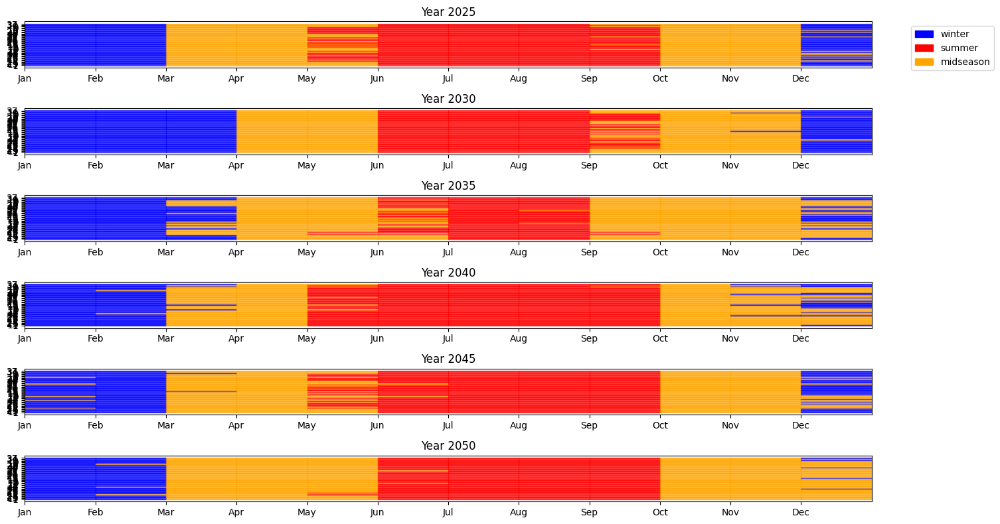

In [ ]:
def plot_node_seasons_comparison(G, num_years=6):
    plt.figure(figsize=(15, 8))
    nodes = list(G.nodes())
    num_nodes = len(nodes)

    # Create a color map for seasons
    season_colors = {"winter": "blue", "summer": "red", "midseason": "orange"}

    for year in range(num_years):
        plt.subplot(num_years, 1, year + 1)

        for node_idx, node in enumerate(nodes):
            seasons = G.nodes[node]["season"].iloc[year * 12 : (year + 1) * 12]

            # Create colored blocks for each season
            for month in range(12):
                # Get single value instead of Series
                season = seasons.iloc[month].item()  # Added .item()
                color = season_colors[season]
                plt.fill_between(
                    [month, month + 1],
                    [node_idx - 0.4],
                    [node_idx + 0.4],
                    color=color,
                    alpha=0.6,
                )

        plt.yticks(range(num_nodes), nodes)
        plt.xlim(0, 12)
        plt.xticks(
            range(12),
            [
                "Jan",
                "Feb",
                "Mar",
                "Apr",
                "May",
                "Jun",
                "Jul",
                "Aug",
                "Sep",
                "Oct",
                "Nov",
                "Dec",
            ],
        )
        plt.title(f"Year {2025 + year*5}")

        # Add a legend (only for the first subplot)
        if year == 0:
            patches = [
                plt.Rectangle((0, 0), 1, 1, color=color)
                for color in season_colors.values()
            ]
            plt.legend(
                patches,
                season_colors.keys(),
                loc="upper right",
                bbox_to_anchor=(1.15, 1),
            )

    plt.tight_layout()
    plt.show()


# Call the function with your graph
plot_node_seasons_comparison(G_undirected)


In [ ]:
G_undirected.edges(data=True)


EdgeDataView([(1, 19, {'weight': 0.75, 'label': 'water_boat'}), (1, 25, {'weight': 0.83, 'label': 'water_boat'}), (1, 24, {'weight': 0.8, 'label': 'winter_tr'}), (19, 25, {'weight': 1.67, 'label': 'water_boat'}), (19, 24, {'weight': 0.69, 'label': 'winter_tr'}), (25, 24, {'weight': 1.08, 'label': 'water_boat'}), (25, 28, {'weight': 0.31, 'label': 'plane'}), (24, 2, {'weight': 46.0, 'label': 'car_cold'}), (24, 12, {'weight': 1.33, 'label': 'plane'}), (24, 23, {'weight': 59.0, 'label': 'car_cold'}), (24, 0, {'weight': 2.0, 'label': 'plane'}), (24, 4, {'weight': 1.01, 'label': 'plane'}), (24, 5, {'weight': 1.93, 'label': 'water_boat'}), (24, 7, {'weight': 2.22, 'label': 'plane'}), (24, 13, {'weight': 0.16, 'label': 'car_cold'}), (24, 14, {'weight': 3.42, 'label': 'water_boat'}), (24, 15, {'weight': 1.84, 'label': 'plane'}), (24, 17, {'weight': 5.13, 'label': 'water_boat'}), (24, 18, {'weight': 1.23, 'label': 'car_cold'}), (24, 20, {'weight': 1.68, 'label': 'water_boat'}), (24, 21, {'weigh

In [ ]:
nx.to_pandas_adjacency(G_undirected)


,1,19,25,24,28,2,12,23,26,27,...,43,22,6,16,8,9,3,10,34,37
1,0.00,0.75,0.83,0.80,0.00,0.00,0.00,0.00,0.00,0.00,...,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
19,0.75,0.00,1.67,0.69,0.00,0.00,0.00,0.00,0.00,0.00,...,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
25,0.83,1.67,0.00,1.08,0.31,0.00,0.00,0.00,0.00,0.00,...,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
24,0.80,0.69,1.08,0.00,1.59,46.00,1.33,59.00,2.54,1.27,...,2.8,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
28,0.00,0.00,0.31,1.59,0.00,0.00,0.00,0.00,0.00,0.00,...,1.5,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
2,0.00,0.00,0.00,46.00,0.00,0.00,4.00,7.00,2.00,3.00,...,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
12,0.00,0.00,0.00,1.33,0.00,4.00,0.00,12.00,1.20,0.58,...,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
23,0.00,0.00,0.00,59.00,0.00,7.00,12.00,0.00,4.65,9.23,...,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
26,0.00,0.00,0.00,2.54,0.00,2.00,1.20,4.65,0.00,0.00,...,0.0,0.59,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00
27,0.00,0.00,0.00,1.27,0.00,3.00,0.58,9.23,0.00,0.00,...,0.0,0.00,1.14,0.00,0.00,0.00,0.00,0.0,0.00,0.00


In [ ]:
G_undirected[24][5]


{'weight': 1.93, 'label': 'water_boat'}

In [ ]:
node_pairs


[(1, 19),
 (1, 25),
 (1, 24),
 (19, 25),
 (19, 24),
 (24, 25),
 (25, 28),
 (2, 24),
 (12, 24),
 (23, 24),
 (0, 24),
 (4, 24),
 (5, 24),
 (7, 24),
 (13, 24),
 (14, 24),
 (15, 24),
 (17, 24),
 (18, 24),
 (20, 24),
 (21, 24),
 (24, 26),
 (24, 27),
 (24, 28),
 (24, 29),
 (24, 30),
 (24, 31),
 (24, 32),
 (24, 33),
 (24, 35),
 (24, 36),
 (24, 38),
 (24, 39),
 (24, 40),
 (24, 41),
 (24, 42),
 (24, 43),
 (5, 28),
 (14, 28),
 (17, 28),
 (20, 28),
 (21, 28),
 (28, 30),
 (28, 33),
 (28, 39),
 (28, 43),
 (2, 12),
 (2, 23),
 (2, 26),
 (2, 27),
 (2, 29),
 (2, 38),
 (2, 41),
 (2, 42),
 (2, 18),
 (7, 12),
 (11, 12),
 (12, 23),
 (12, 26),
 (12, 27),
 (12, 29),
 (12, 41),
 (7, 23),
 (23, 26),
 (23, 27),
 (23, 29),
 (7, 26),
 (22, 26),
 (26, 29),
 (26, 41),
 (6, 27),
 (7, 27),
 (11, 27),
 (27, 41),
 (27, 29),
 (7, 29),
 (29, 31),
 (29, 41),
 (13, 38),
 (18, 38),
 (7, 41),
 (16, 41),
 (41, 42),
 (16, 42),
 (18, 30),
 (13, 18),
 (18, 32),
 (0, 10),
 (0, 35),
 (5, 14),
 (5, 17),
 (5, 20),
 (5, 30),
 (5, 33)

In [ ]:
# Create a list of dictionaries to store node pairs and their connection details
node_pairs = []
pair_connections = {}

for u, v, data in G_undirected.edges(data=True):
    pair = tuple(sorted([u, v]))

    if pair not in pair_connections:
        pair_connections[pair] = []

    # Store the connection details (transport mode and weight)
    connection = {"mode": data.get("label"), "weight": data.get("weight")}

    # Only add if this exact combination doesn't exist yet
    if connection not in pair_connections[pair]:
        pair_connections[pair].append(connection)

# Convert to list format if needed
node_pairs = [(pair, connections) for pair, connections in pair_connections.items()]

# Example of how to print the results:
for pair, connections in node_pairs:
    print(f"\nConnection between {pair[0]} and {pair[1]}:")
    for conn in connections:
        print(f"  - Mode: {conn['mode']}, Weight: {conn['weight']}")



Connection between 1 and 19:
  - Mode: water_boat, Weight: 0.75

Connection between 1 and 25:
  - Mode: water_boat, Weight: 0.83

Connection between 1 and 24:
  - Mode: winter_tr, Weight: 0.8

Connection between 19 and 25:
  - Mode: water_boat, Weight: 1.67

Connection between 19 and 24:
  - Mode: winter_tr, Weight: 0.69

Connection between 24 and 25:
  - Mode: water_boat, Weight: 1.08

Connection between 25 and 28:
  - Mode: plane, Weight: 0.31

Connection between 2 and 24:
  - Mode: car_cold, Weight: 46.0

Connection between 12 and 24:
  - Mode: plane, Weight: 1.33

Connection between 23 and 24:
  - Mode: car_cold, Weight: 59.0

Connection between 0 and 24:
  - Mode: plane, Weight: 2.0

Connection between 4 and 24:
  - Mode: plane, Weight: 1.01

Connection between 5 and 24:
  - Mode: water_boat, Weight: 1.93

Connection between 7 and 24:
  - Mode: plane, Weight: 2.22

Connection between 13 and 24:
  - Mode: car_cold, Weight: 0.16

Connection between 14 and 24:
  - Mode: water_boat, 

/var/folders/jn/d6x3c7jd7594dtldxq22ysn80000gn/T/ipykernel_57979/2118568193.py:49: UserWarning: 

The connectionstyle keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default values.
Note that using FancyArrowPatches may be slow for large graphs.

  nx.draw_networkx_edges(


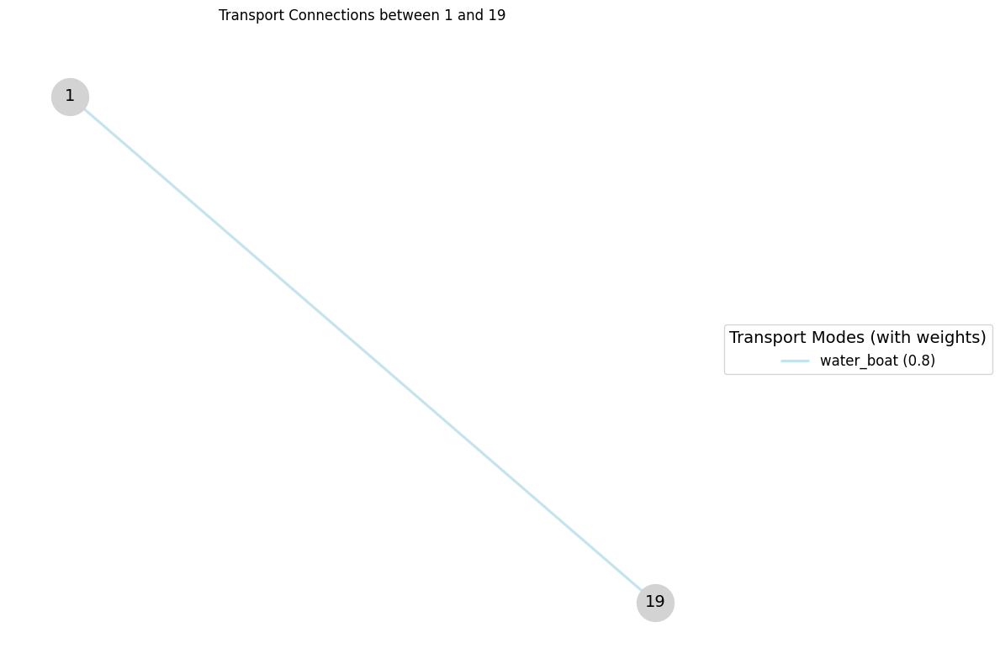

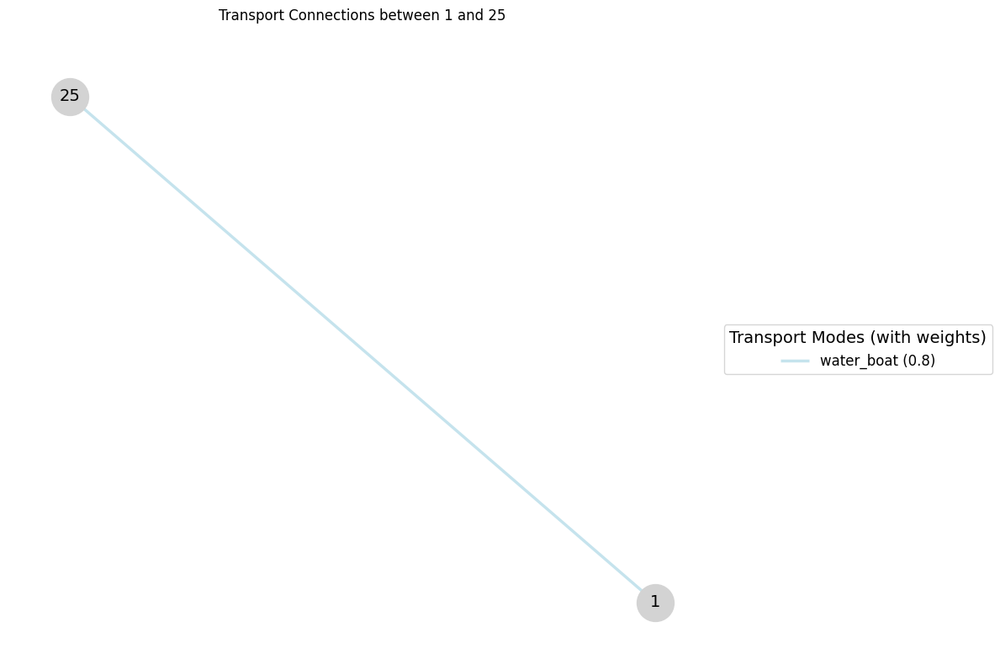

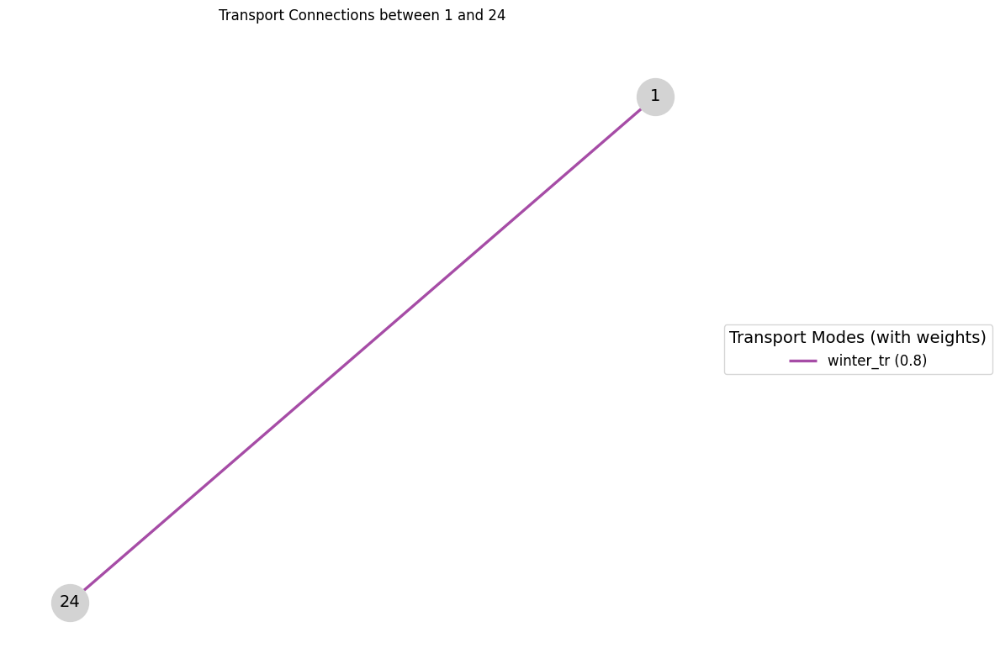

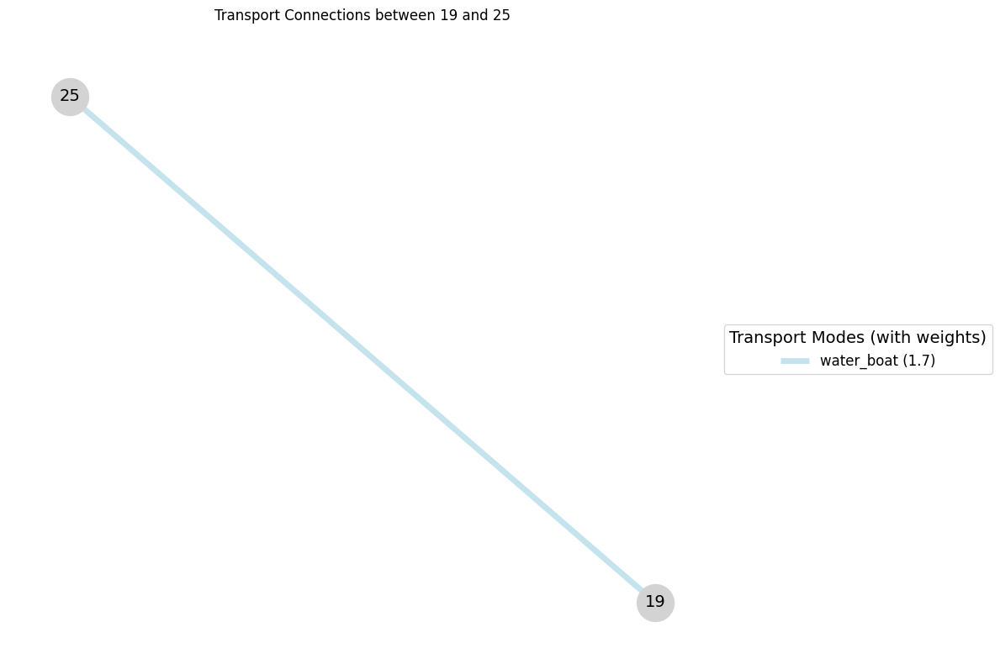

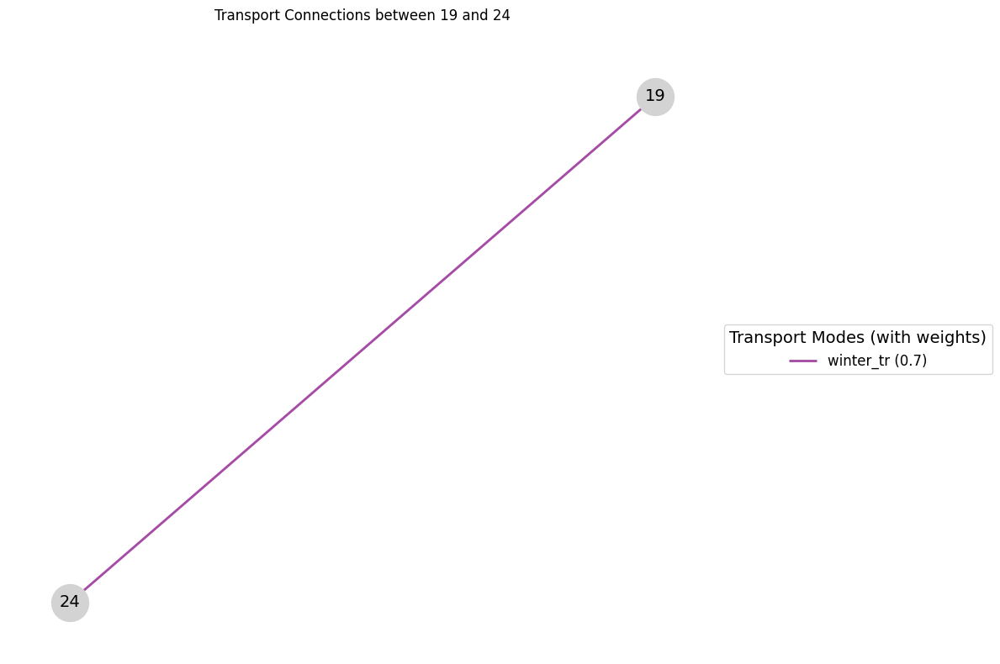

...

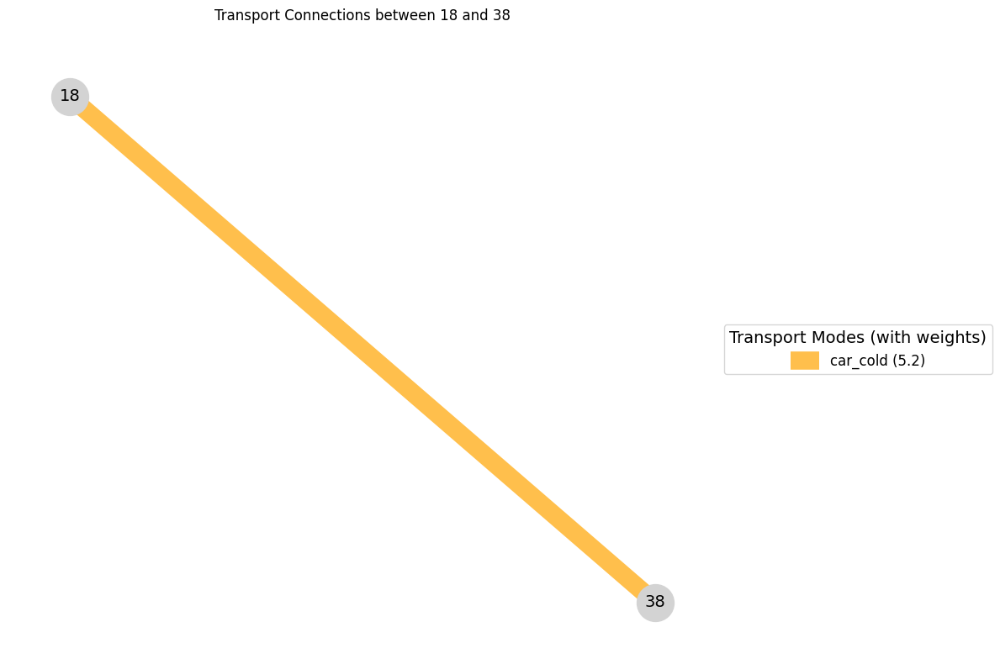

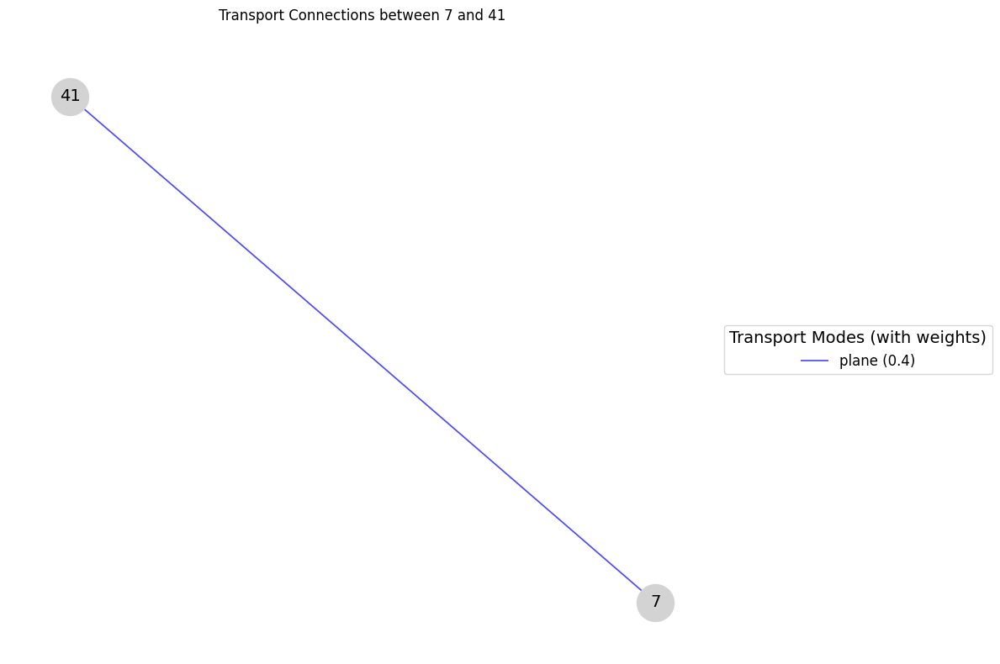

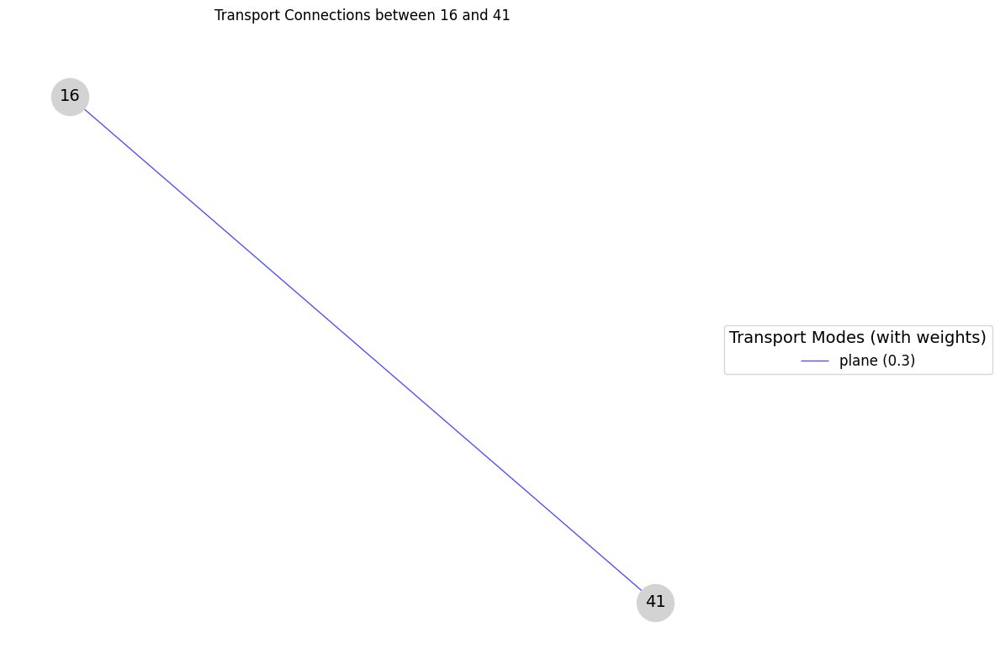

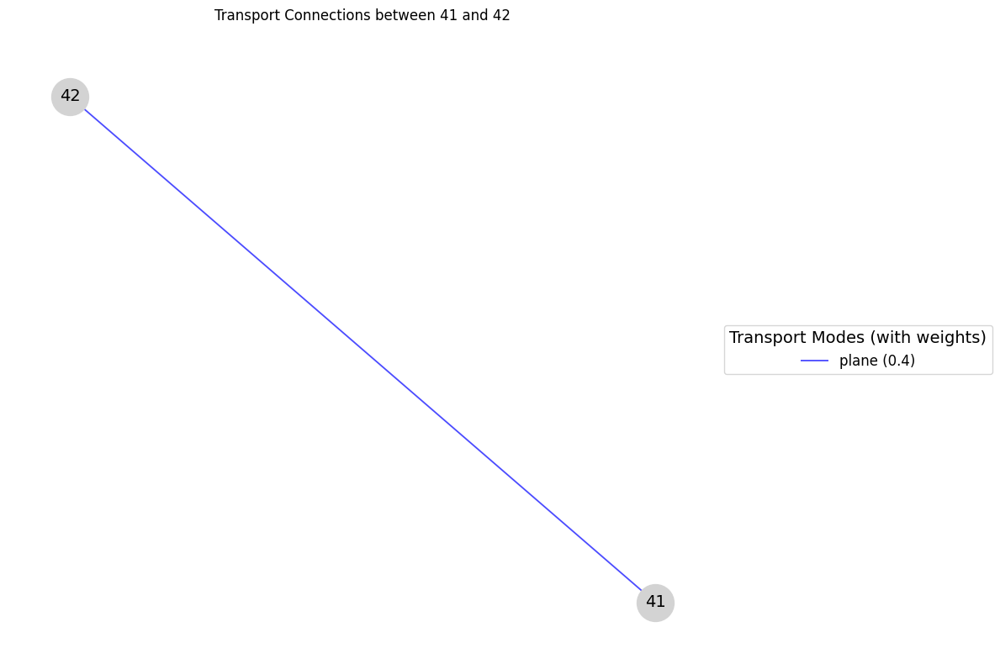

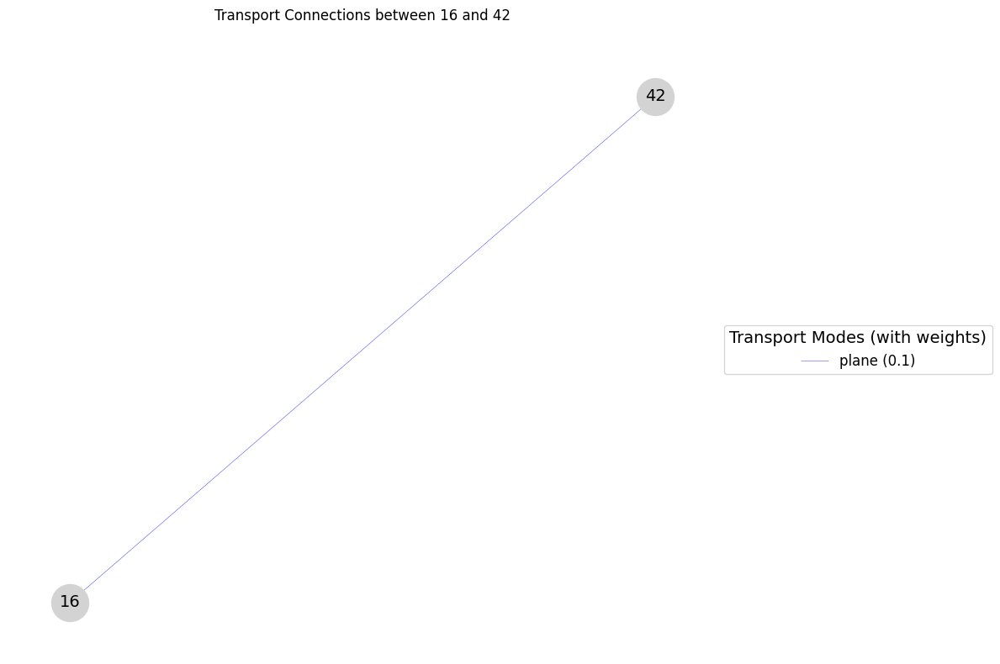

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x107700c10>>
Traceback (most recent call last):
  File "/Users/test/Documents/code/iccs25/.venv/lib/python3.11/site-packages/ipykernel/ipkernel.py", line 775, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(

KeyboardInterrupt: 


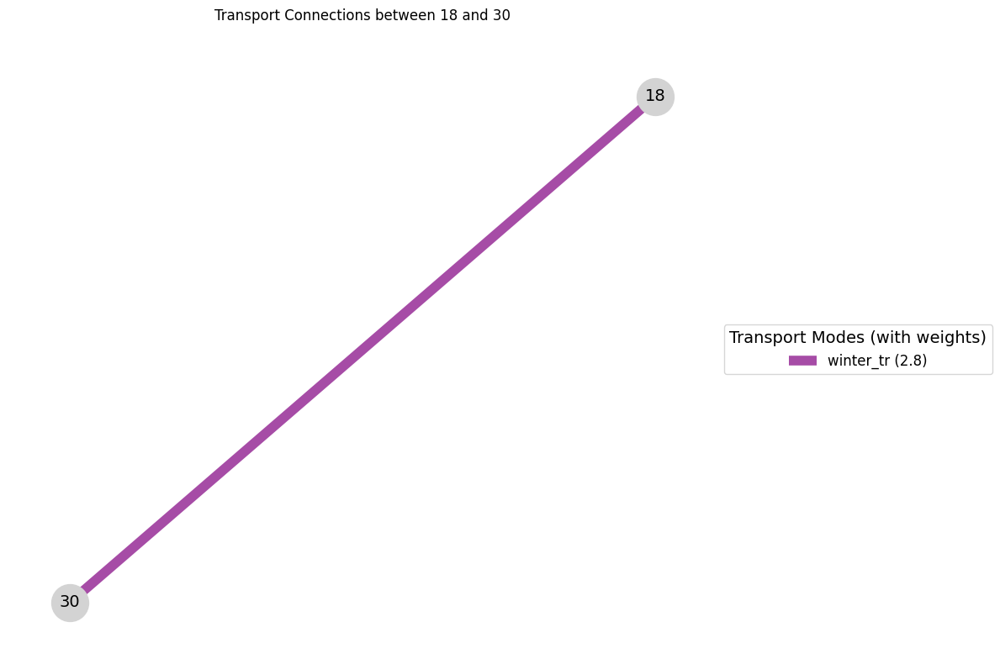

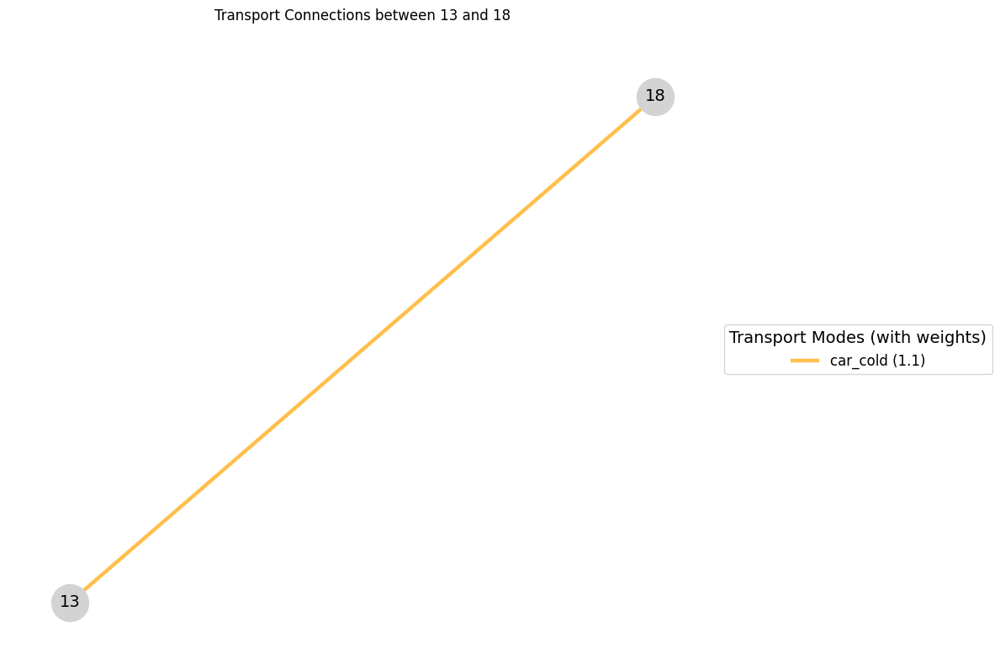

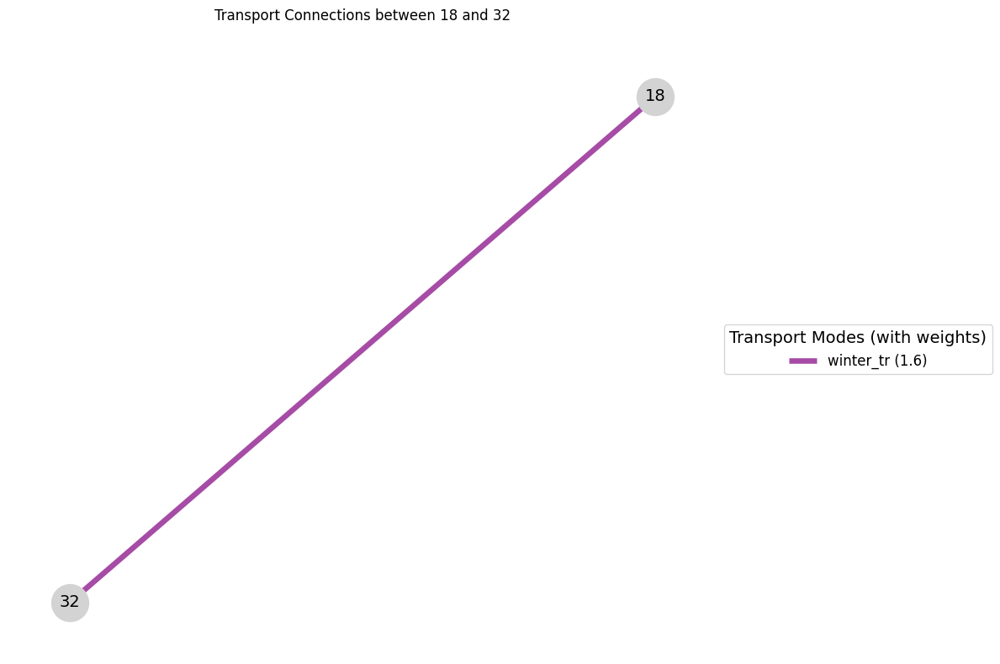

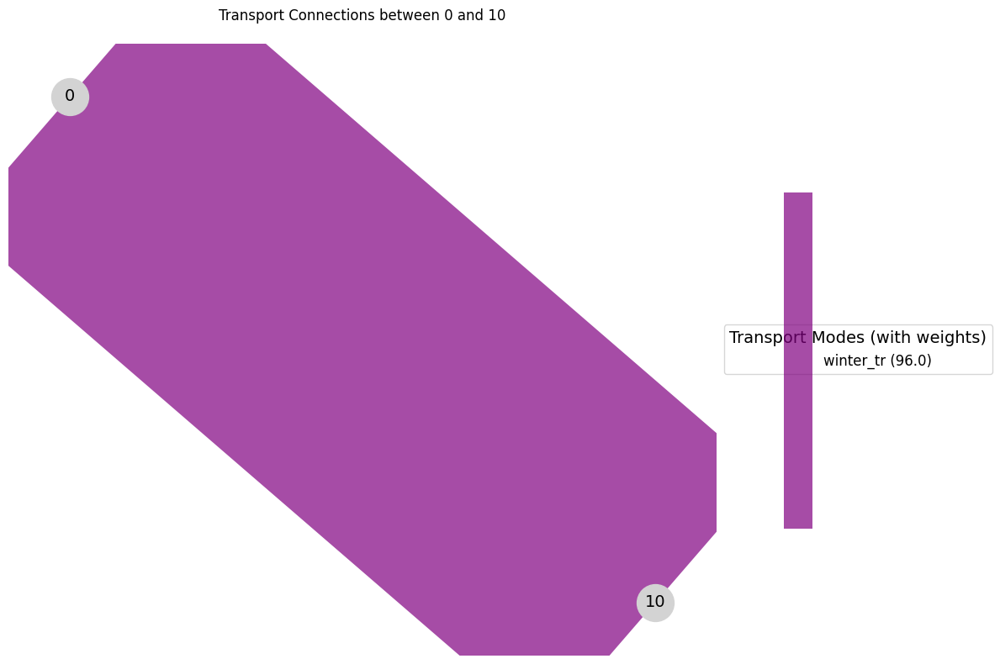

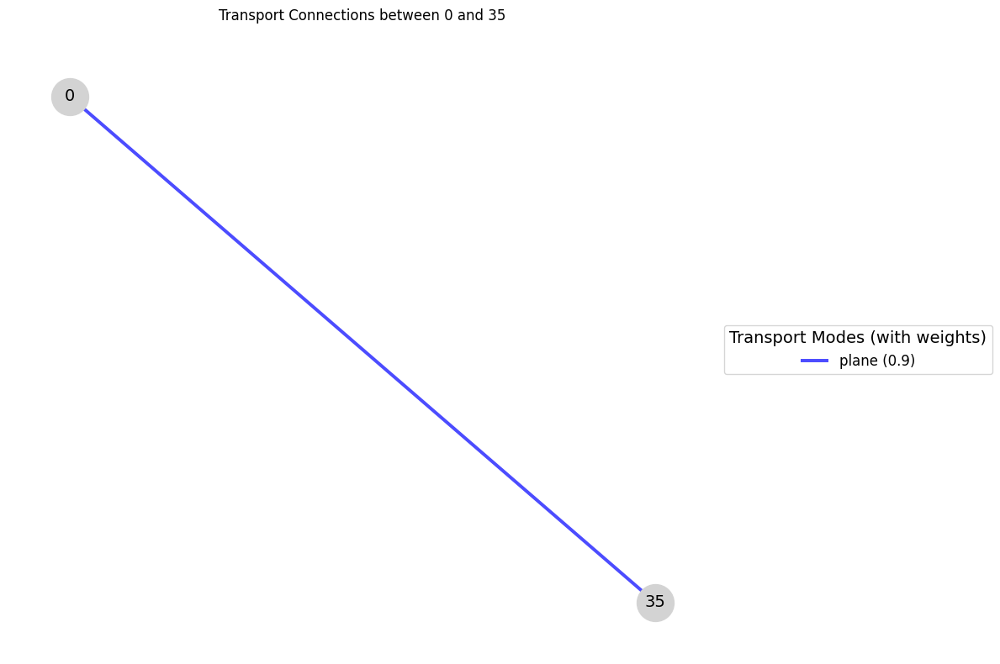

...

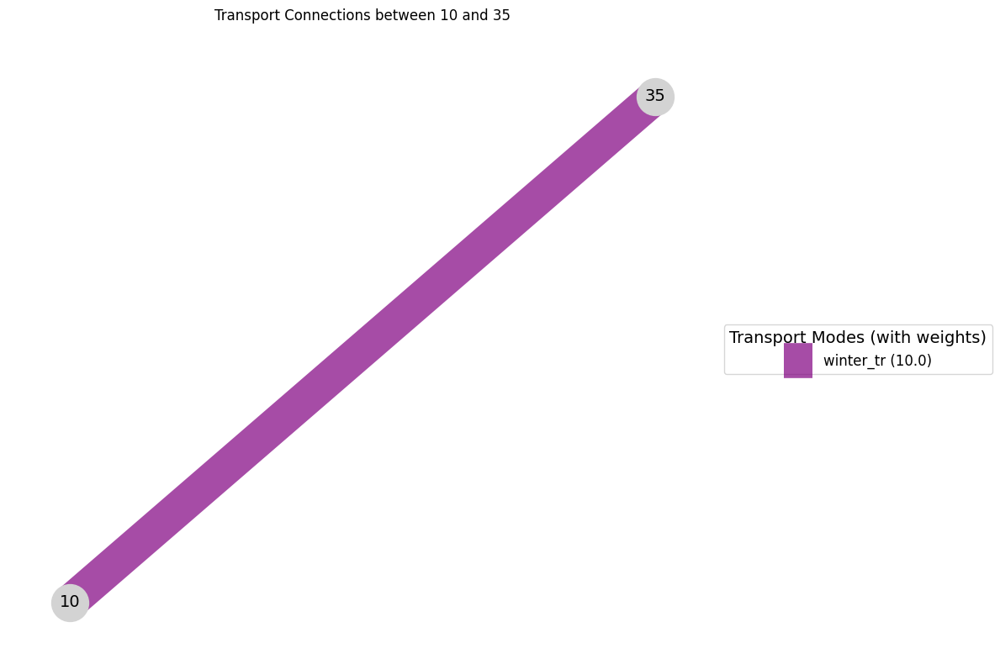

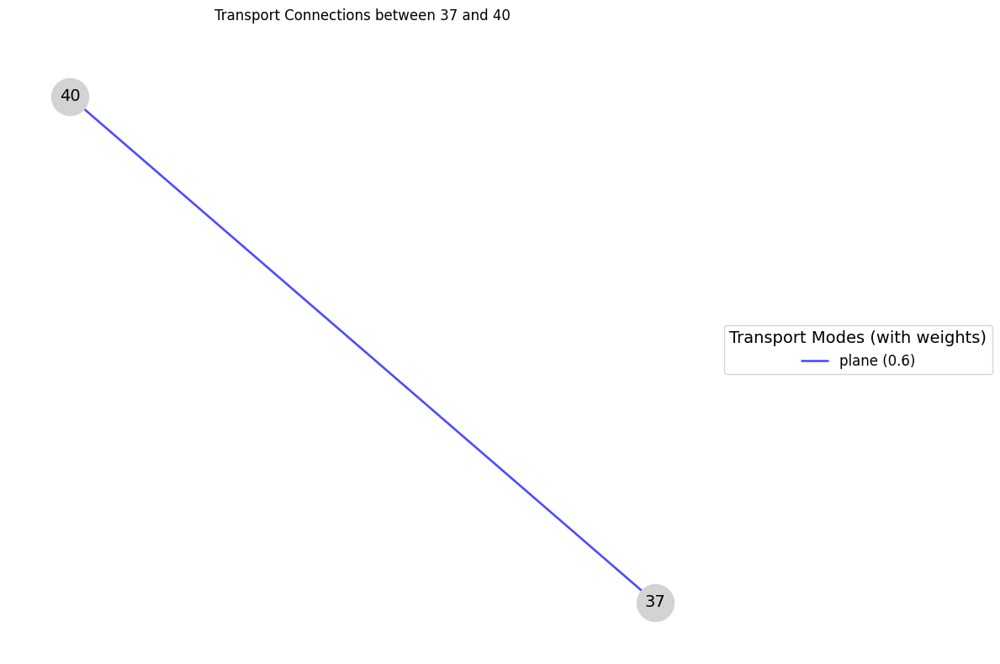

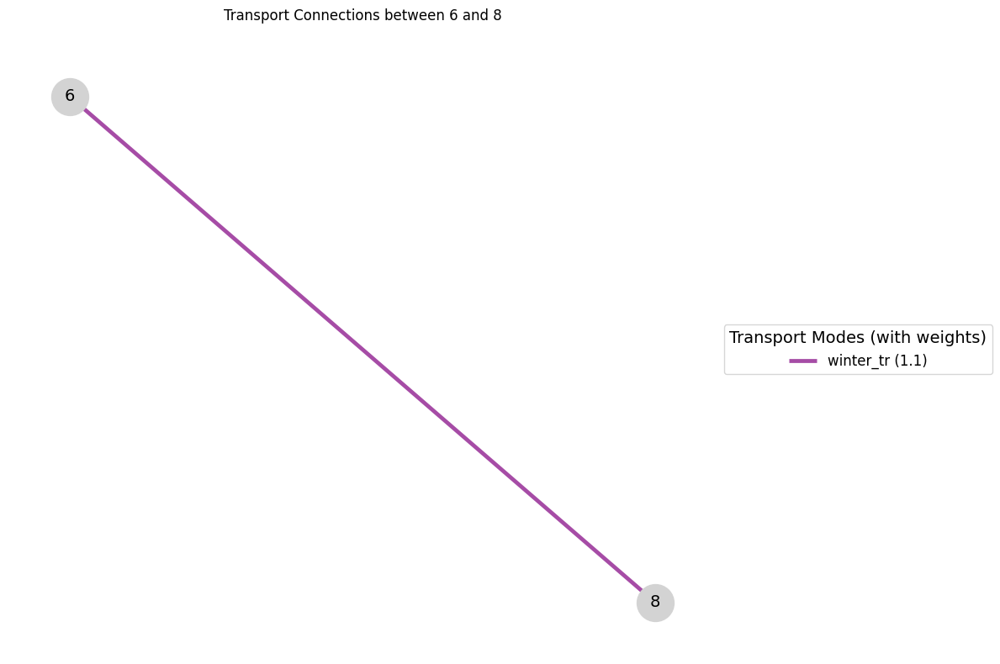

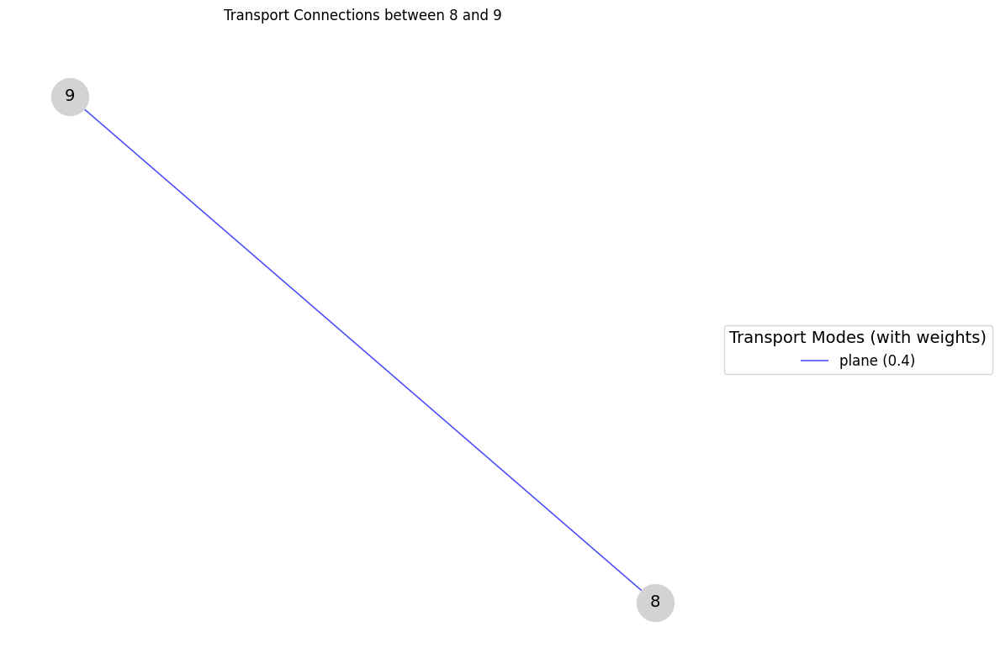

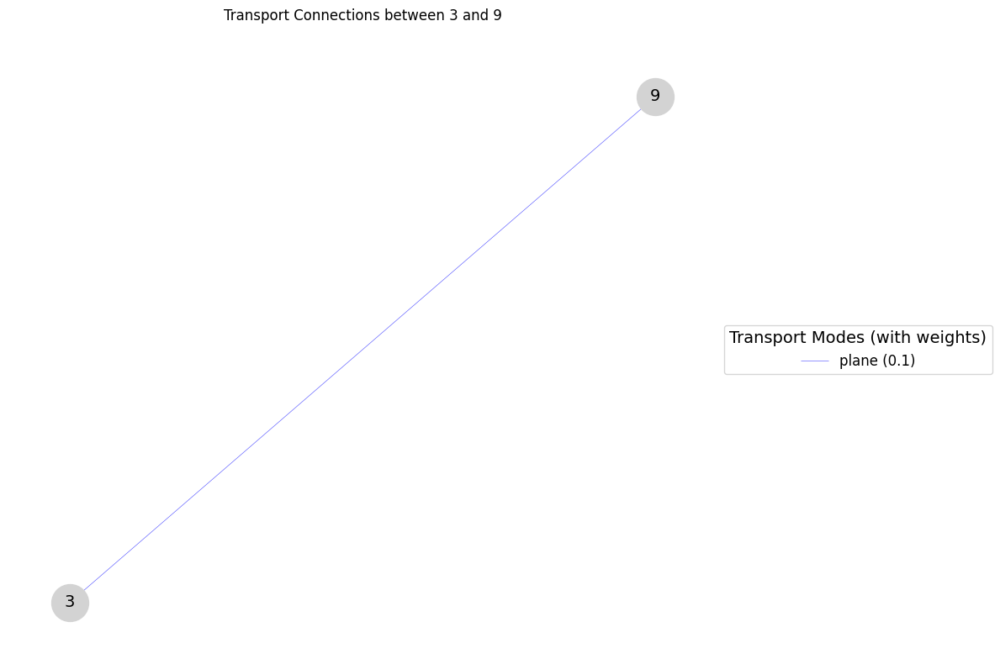

In [ ]:
def plot_node_pair_connections(G, node1, node2):
    """
    Plot all transport connections between two specific nodes, including duplicates with different weights
    """
    plt.figure(figsize=(12, 8))

    # Define colors for different transport modes
    transport_colors = {
        "car_warm": "red",
        "plane": "blue",
        "water_ship": "darkblue",
        "water_boat": "lightblue",
        "car_cold": "orange",
        "winter_tr": "purple",
    }

    # Get node positions
    pos = {
        node: (G.nodes[node]["x"] * 1.5, G.nodes[node]["y"] * 1.5) for node in G.nodes()
    }

    # Draw only the two nodes of interest
    nx.draw_networkx_nodes(
        G, pos, nodelist=[node1, node2], node_size=1000, node_color="lightgray"
    )
    nx.draw_networkx_labels(G, pos, labels={node1: node1, node2: node2}, font_size=14)

    # Find and group edges by their properties
    edge_groups = {}
    for u, v, data in G.edges(data=True):
        if (u == node1 and v == node2) or (u == node2 and v == node1):
            key = (data.get("label"), data.get("weight"))
            if key not in edge_groups:
                edge_groups[key] = []
            edge_groups[key].append((u, v, data))

    # Draw edges with different curves
    for idx, ((mode, weight), edges) in enumerate(edge_groups.items()):
        if mode in transport_colors:
            # Calculate curve offset based on index
            rad = 0.2 + (idx * 0.15)  # Increased spacing between curves

            # Scale width by weight
            width = weight * 3 if weight else 3  # Increased width scaling

            # Draw edge with curved path
            for u, v, data in edges:
                nx.draw_networkx_edges(
                    G,
                    pos,
                    edgelist=[(u, v)],
                    edge_color=transport_colors[mode],
                    width=width,
                    alpha=0.7,
                    label=f"{mode} ({weight:.1f})",
                    connectionstyle=f"arc3, rad={rad}",
                )

    plt.title(f"Transport Connections between {node1} and {node2}", pad=20)
    plt.legend(
        loc="center left",
        bbox_to_anchor=(1, 0.5),
        fontsize=12,
        title="Transport Modes (with weights)",
        title_fontsize=14,
    )
    plt.axis("off")
    plt.tight_layout()
    plt.show()


# Find unique node pairs
node_pairs = []
for u, v in G_undirected.edges():
    pair = tuple(sorted([u, v]))
    if pair not in node_pairs:
        node_pairs.append(pair)

# Plot connections for each node pair
for node1, node2 in node_pairs:
    plot_node_pair_connections(G_undirected, node1, node2)


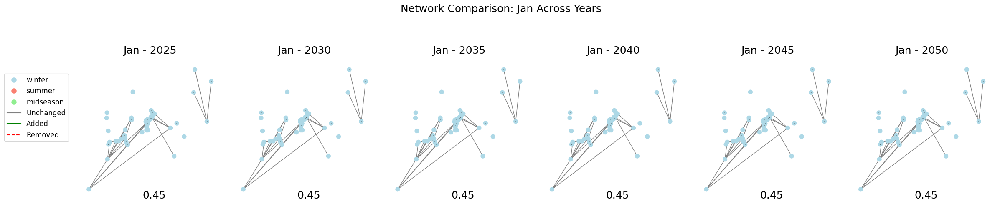

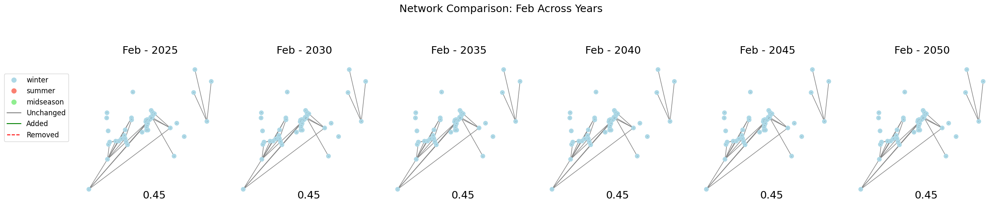

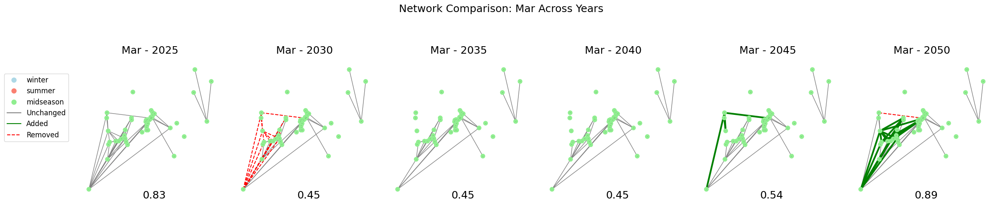

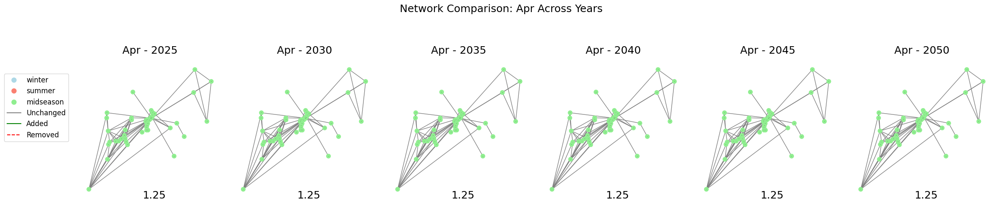

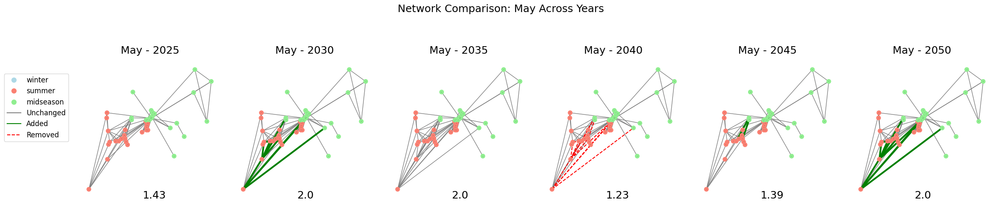

...

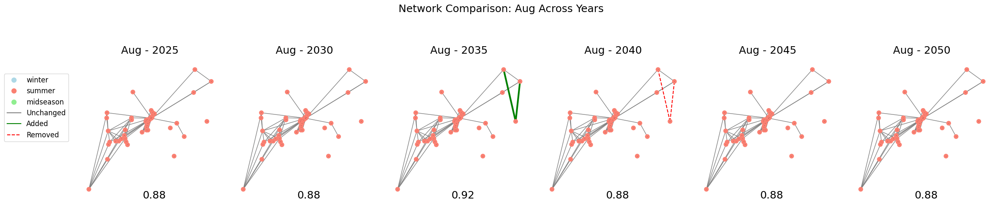

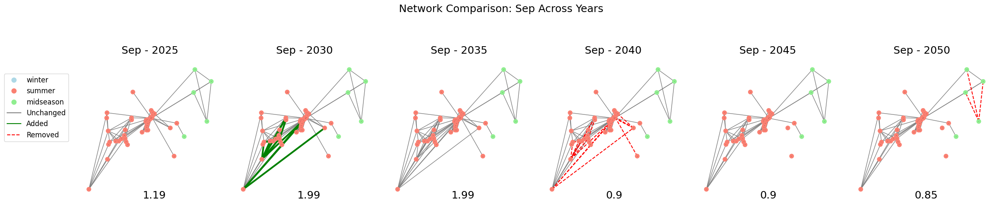

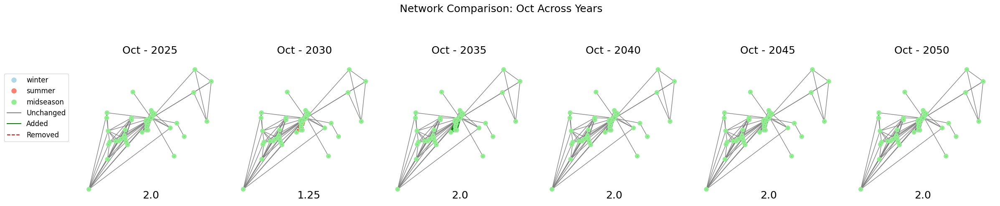

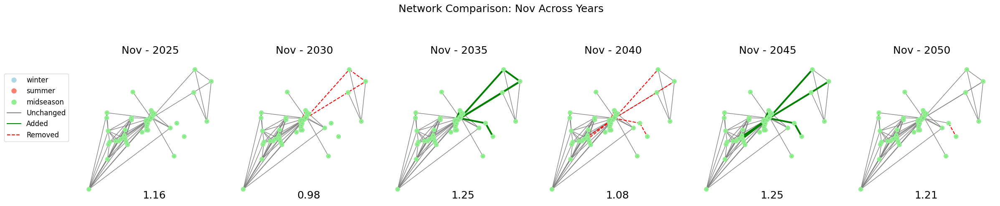

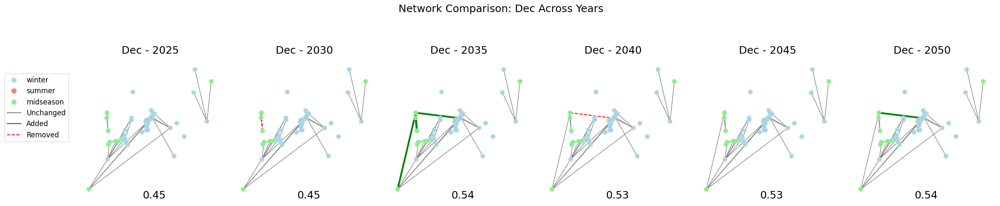

In [ ]:
def plot_colored_graph_by_season_comparison(G, month_idx, graphs, stats):
    """
    Plot comparison of network states for a given month across all years
    """
    fig, axes = plt.subplots(1, len(graphs), figsize=(4 * len(graphs), 5))

    # Handle case of 1 subplot
    if len(graphs) == 1:
        axes = [axes]

    # Get node positions from original graph
    pos = {node: (G.nodes[node]["x"], G.nodes[node]["y"]) for node in G.nodes()}

    # Color mapping for seasons
    season_colors = {
        "winter": "lightblue",
        "summer": "salmon",
        "midseason": "lightgreen",
    }

    month_names = [
        "Jan",
        "Feb",
        "Mar",
        "Apr",
        "May",
        "Jun",
        "Jul",
        "Aug",
        "Sep",
        "Oct",
        "Nov",
        "Dec",
    ]

    for i, (year_G, stat) in enumerate(zip(graphs, stats)):
        ax = axes[i]
        ax.set_title(f"{month_names[month_idx]} - {2025 + i*5}", fontsize=18)

        # Get node colors for current timestep
        node_colors = [
            season_colors[year_G.nodes[node]["season"].iloc[month_idx].item()]
            for node in year_G.nodes()
        ]

        # Detect edge changes vs previous year
        if i > 0:
            prev_edges = set(graphs[i - 1].edges())
            curr_edges = set(year_G.edges())

            added = curr_edges - prev_edges
            removed = prev_edges - curr_edges
            unchanged = curr_edges & prev_edges
        else:
            added = removed = set()
            unchanged = set(year_G.edges())

        # Draw edges with different styles based on their status
        nx.draw_networkx_edges(
            year_G, pos, edgelist=list(unchanged), edge_color="gray", width=1, ax=ax
        )
        nx.draw_networkx_edges(
            year_G,
            pos,
            edgelist=list(added),
            edge_color="green",
            width=3,
            style="solid",
            ax=ax,
        )
        if i > 0:
            nx.draw_networkx_edges(
                year_G,
                pos,
                edgelist=list(removed),
                edge_color="red",
                width=1.5,
                style="dashed",
                ax=ax,
            )

        # Draw nodes with seasonal colors
        nx.draw_networkx_nodes(year_G, pos, node_color=node_colors, node_size=50, ax=ax)
        nx.draw_networkx_labels(year_G, pos, font_size=0, ax=ax)

        # Add connectivity metric
        stat_text = f"\n\n{round(stat,2)}"
        ax.text(
            0.45,
            0.01,
            stat_text,
            transform=ax.transAxes,
            fontsize=18,
            verticalalignment="bottom",
            bbox=dict(facecolor="white", alpha=0.7, edgecolor="none"),
        )

        ax.set_axis_off()

    # Add legend to first subplot
    legend_elements = []
    # Season legend
    for season, color in season_colors.items():
        legend_elements.append(
            plt.Line2D(
                [0],
                [0],
                marker="o",
                color="w",
                markerfacecolor=color,
                label=season,
                markersize=10,
            )
        )
    # Edge type legend
    legend_elements.extend(
        [
            plt.Line2D([0], [0], color="gray", label="Unchanged"),
            plt.Line2D([0], [0], color="green", label="Added"),
            plt.Line2D([0], [0], color="red", linestyle="--", label="Removed"),
        ]
    )
    # Change this line to move legend outside:
    axes[0].legend(
        handles=legend_elements,
        bbox_to_anchor=(-0.05, 0.65),  # Move legend left and slightly up
        loc="center right",
        borderaxespad=0,
        frameon=True,
        fontsize=12,
    )

    fig.suptitle(
        f"Network Comparison: {month_names[month_idx]} Across Years\n\n", fontsize=18
    )
    plt.tight_layout()
    plt.show()


# Organize the visualization by month
def plot_network_evolution_by_month(net):
    graphs_by_month = [[] for _ in range(12)]
    stats_by_month = [[] for _ in range(12)]

    for i, G in enumerate(net.stats.graphs):
        month_index = i % 12
        graphs_by_month[month_index].append(G)
        stats_by_month[month_index].append(net.stats.records["metric"].iloc[i])

    # Plot each month's evolution
    for month_idx in range(12):
        plot_colored_graph_by_season_comparison(
            G_undirected,
            month_idx,
            graphs_by_month[month_idx],
            stats_by_month[month_idx],
        )


# Call the visualization
plot_network_evolution_by_month(net)


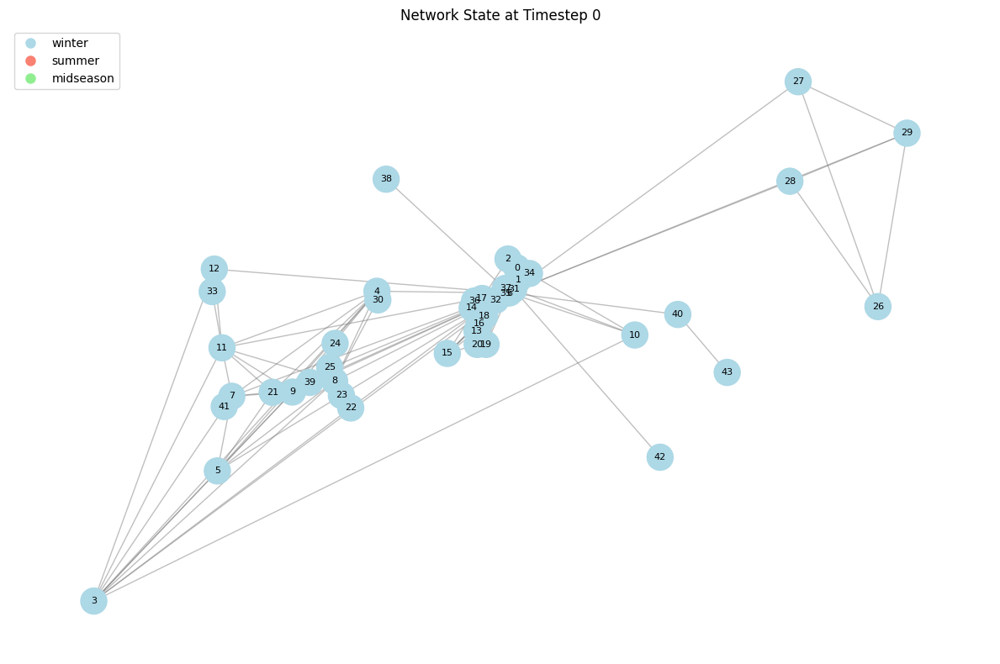

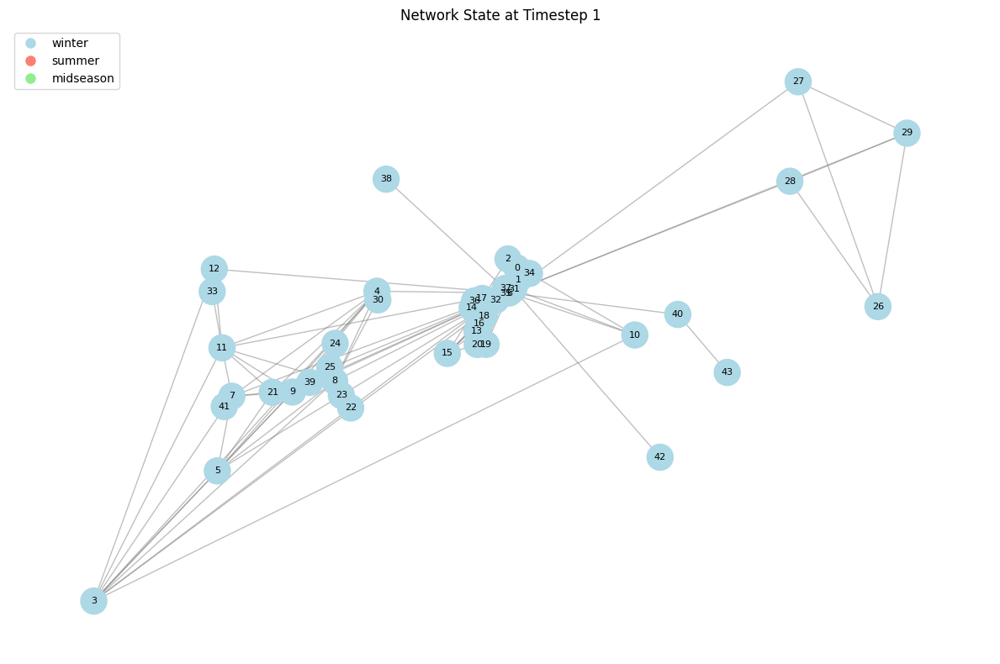

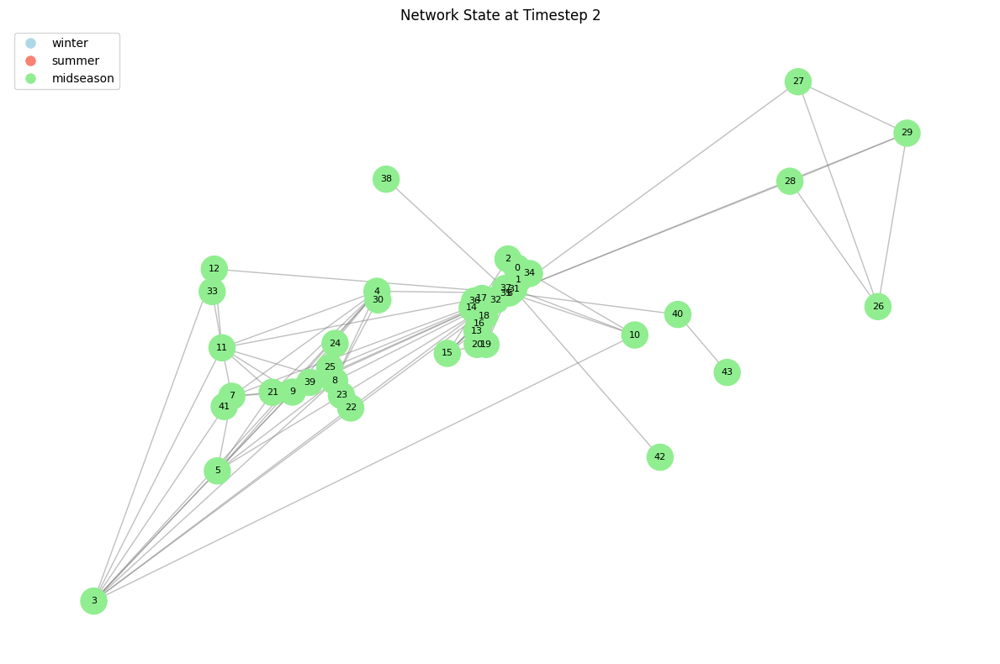

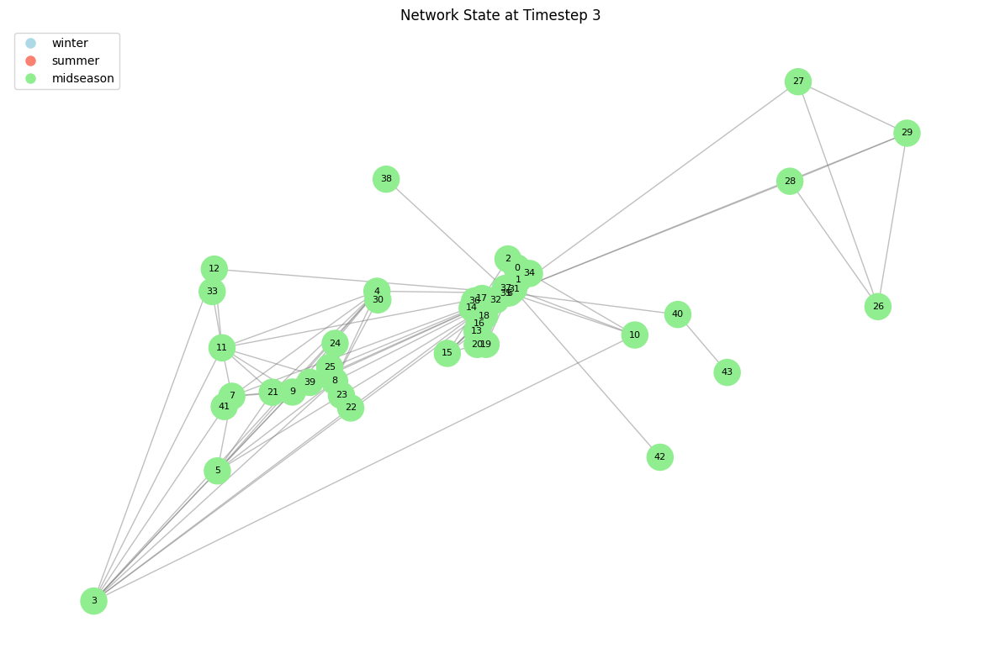

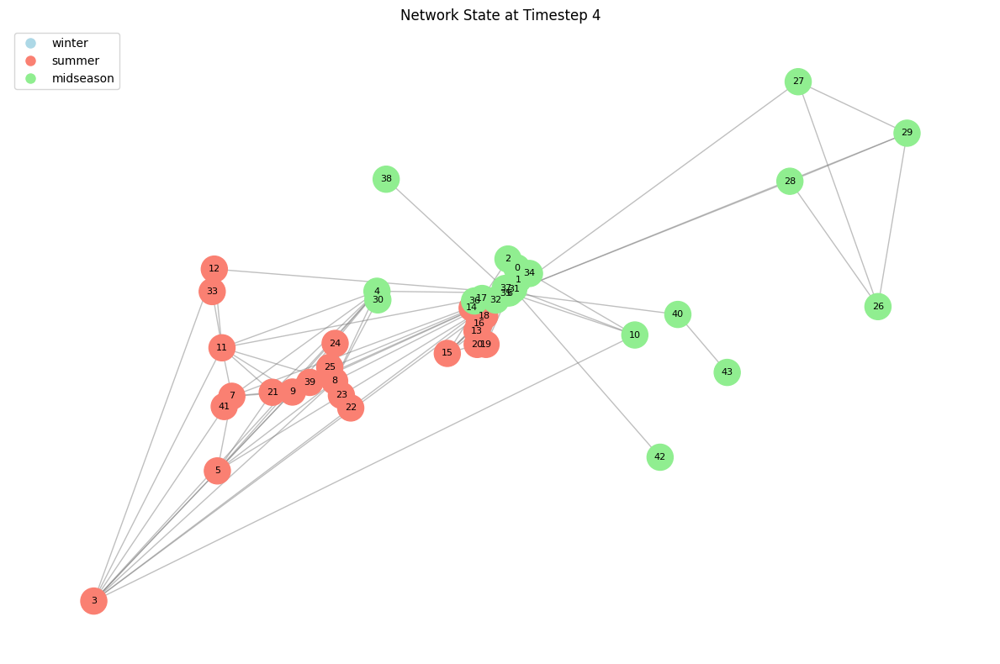

...

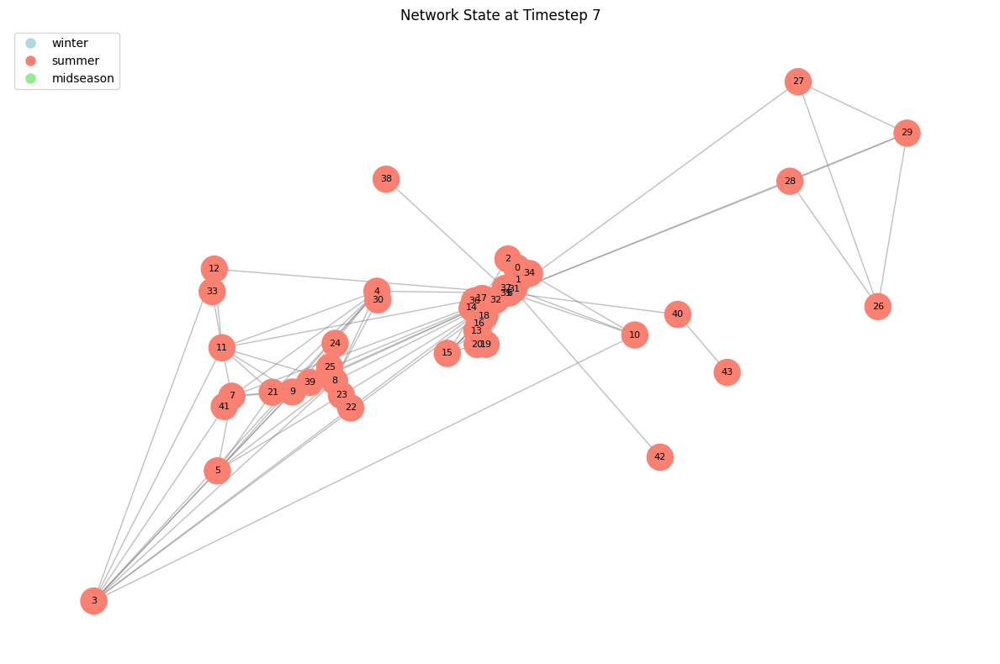

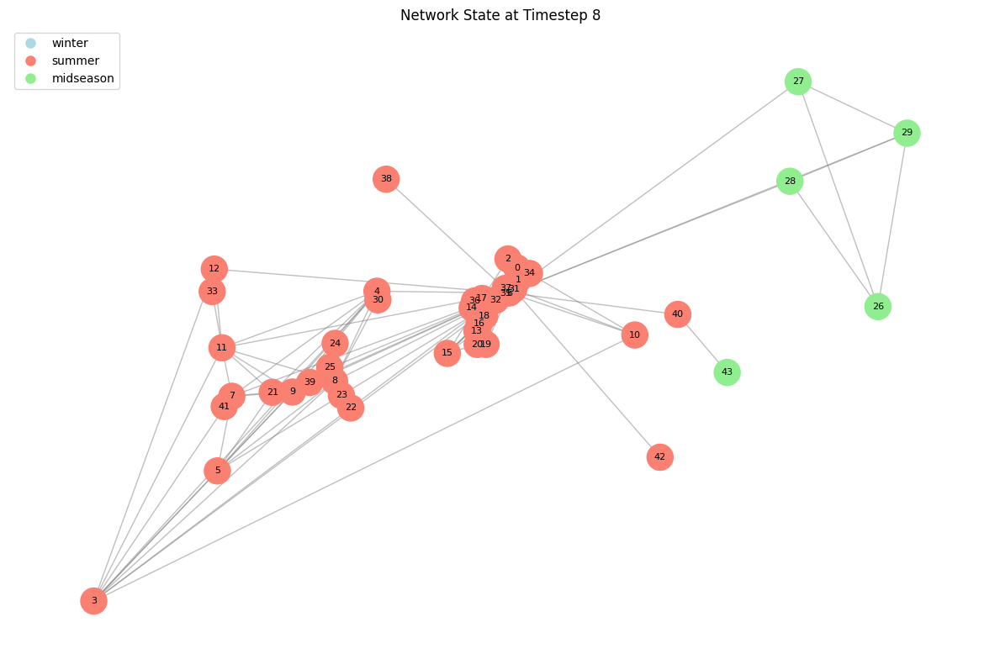

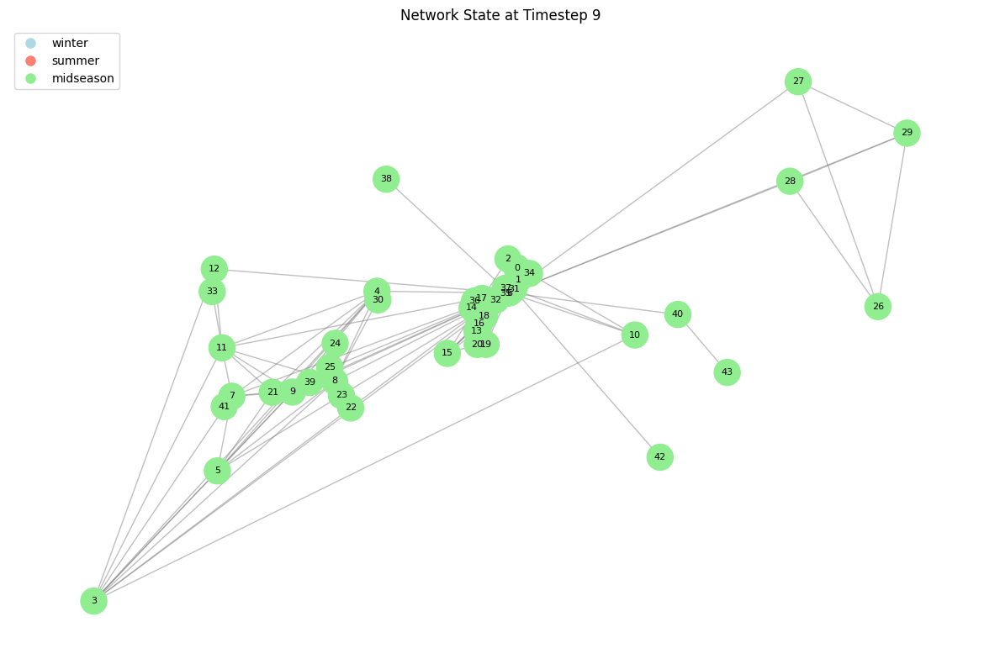

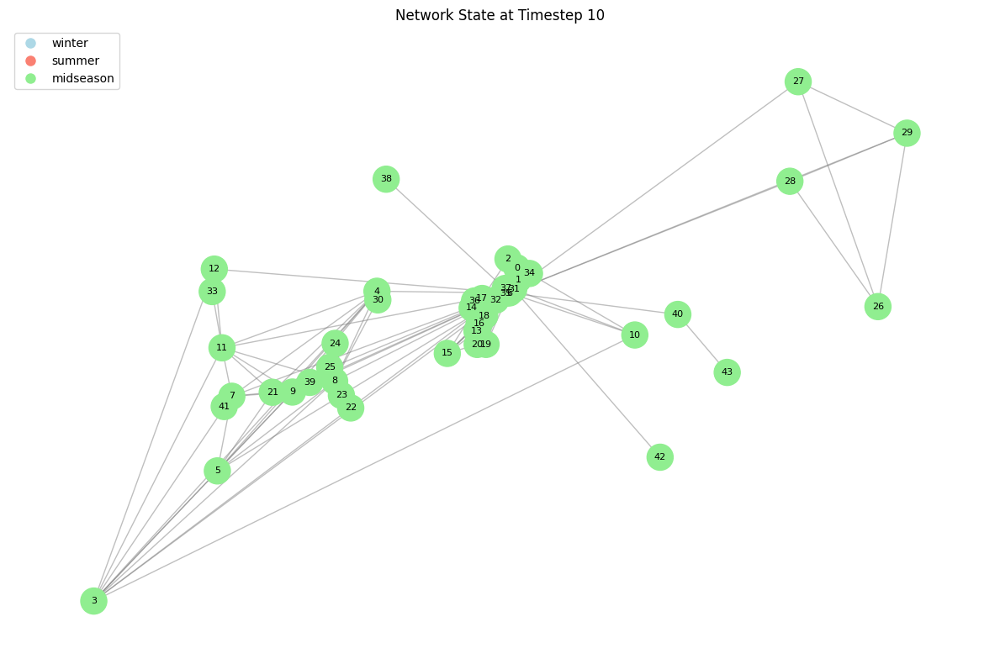

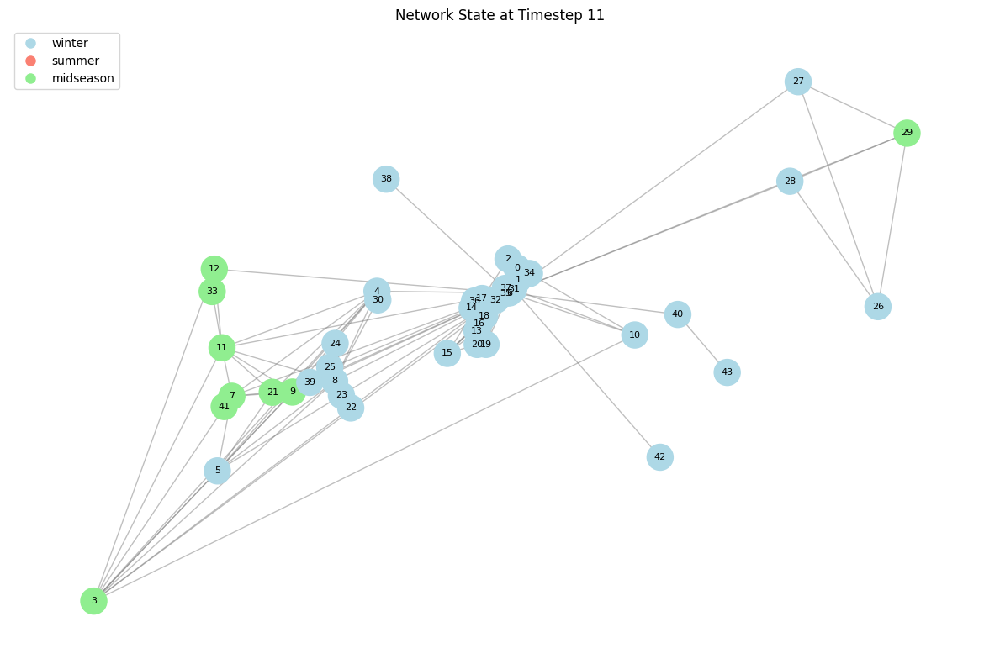

In [ ]:
def plot_colored_graph_by_season(G, timestep):
    """
    Plot graph with nodes colored by their season at given timestep
    """
    plt.figure(figsize=(12, 8))

    # Color mapping for seasons
    season_colors = {
        "winter": "lightblue",
        "summer": "salmon",
        "midseason": "lightgreen",
    }

    # Get node positions from latitude/longitude
    pos = {node: (G.nodes[node]["x"], G.nodes[node]["y"]) for node in G.nodes()}

    # Get seasons for each node at current timestep - use .item() to get single value
    node_colors = [
        season_colors[G.nodes[node]["season"].iloc[timestep].item()]
        for node in G.nodes()
    ]

    # Draw edges
    nx.draw_networkx_edges(G, pos, edge_color="gray", width=1, alpha=0.5)

    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500)

    # Add labels
    nx.draw_networkx_labels(G, pos, font_size=8)

    # Add legend
    legend_elements = [
        plt.Line2D(
            [0],
            [0],
            marker="o",
            color="w",
            markerfacecolor=color,
            label=season,
            markersize=10,
        )
        for season, color in season_colors.items()
    ]
    plt.legend(handles=legend_elements, loc="upper left")

    plt.title(f"Network State at Timestep {timestep}")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


# Create an animation showing how seasons change over time
def plot_seasonal_evolution(G, num_timesteps=12):
    """
    Plot sequence of graphs showing seasonal changes
    num_timesteps: number of time steps to show (default: one year)
    """
    for t in range(num_timesteps):
        plot_colored_graph_by_season(G, t)
        plt.close()


# Call the function to visualize seasonal changes over one year
plot_seasonal_evolution(G_undirected)


## Графики изменения температур(ы)

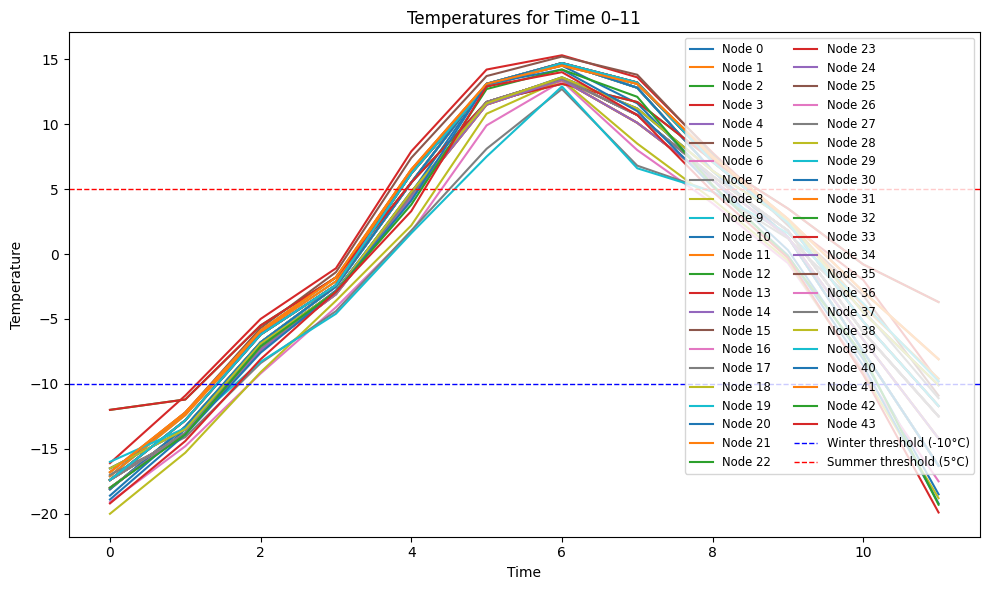

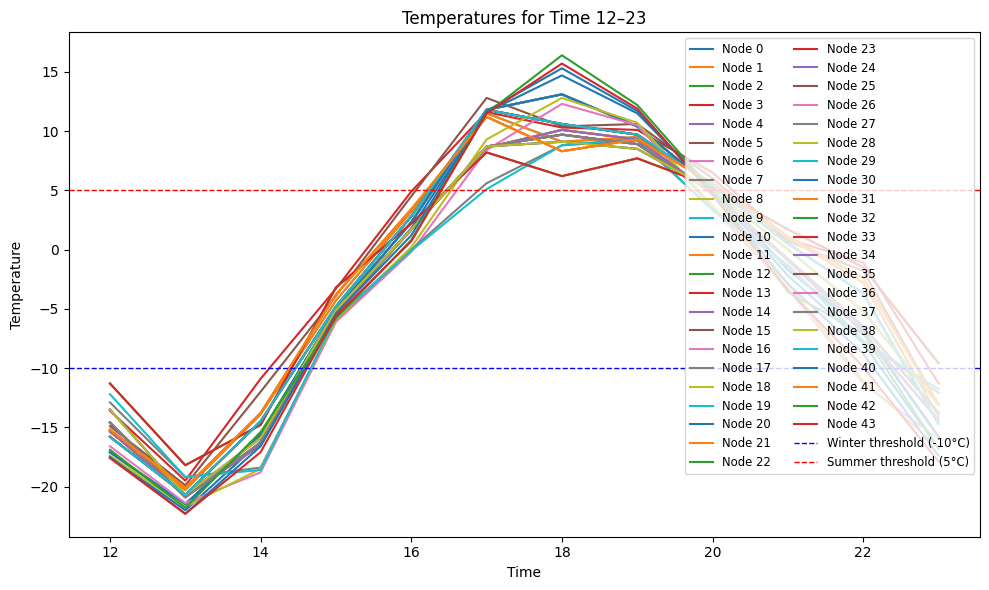

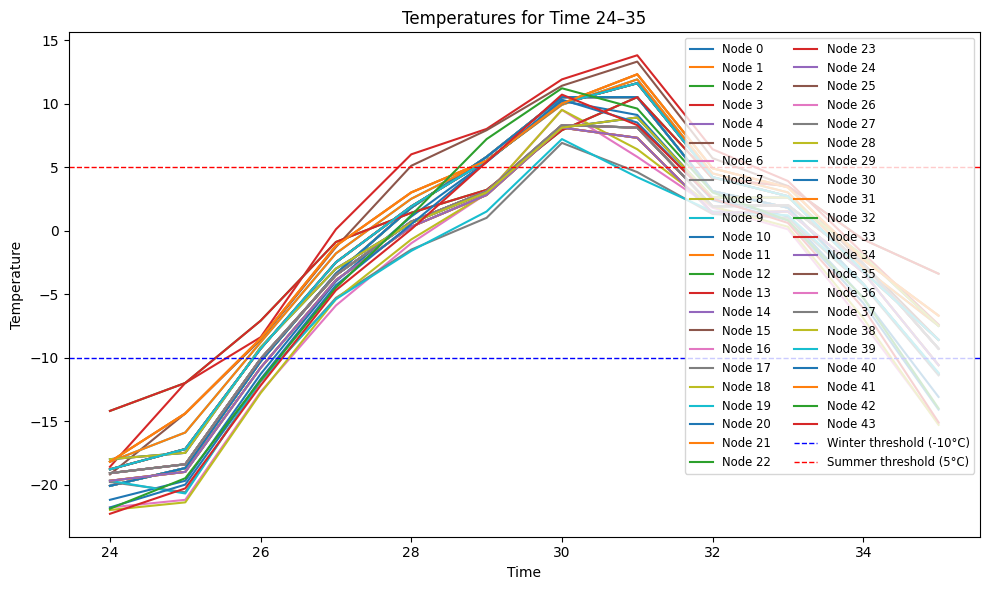

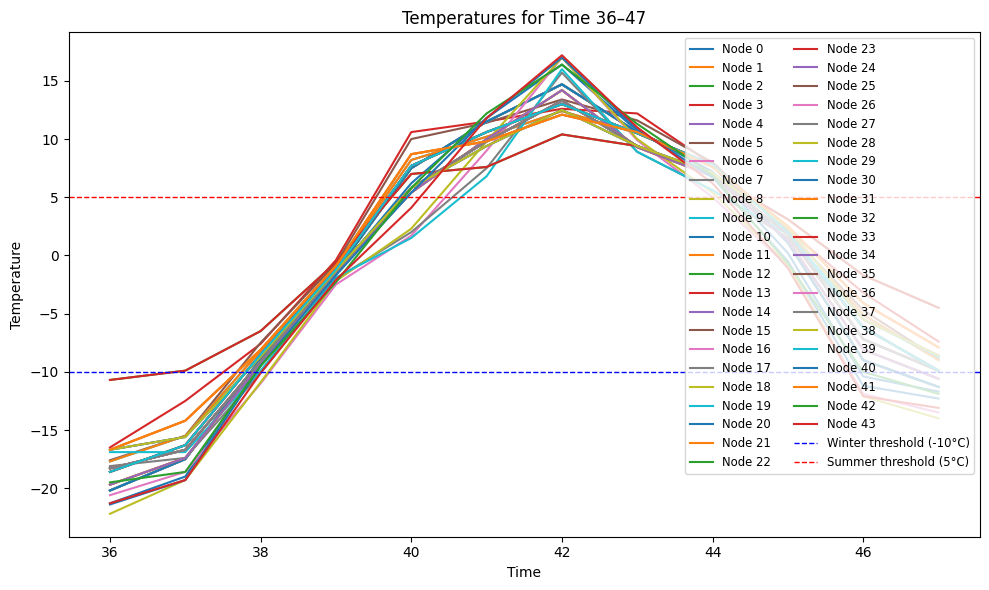

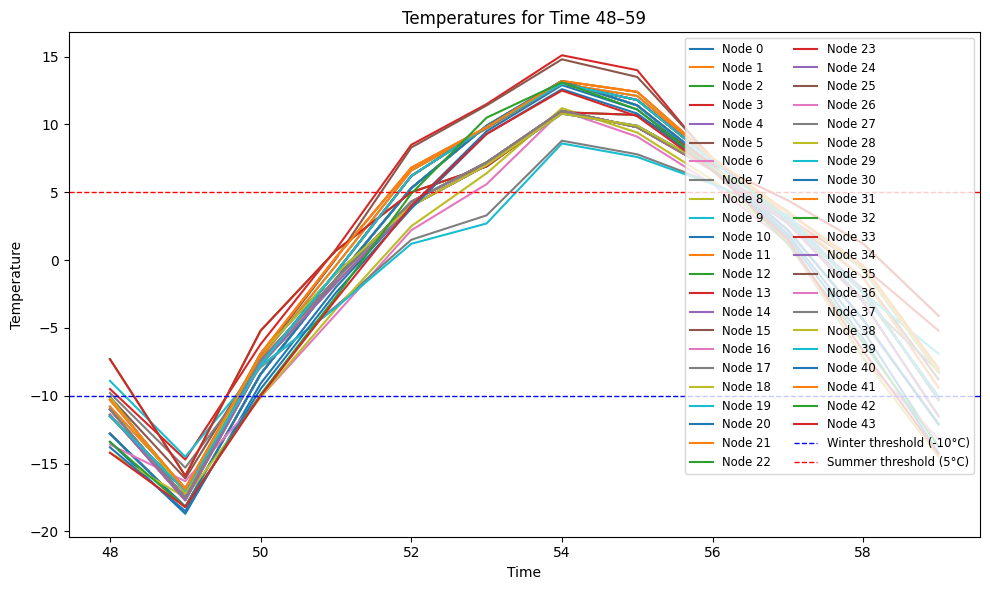

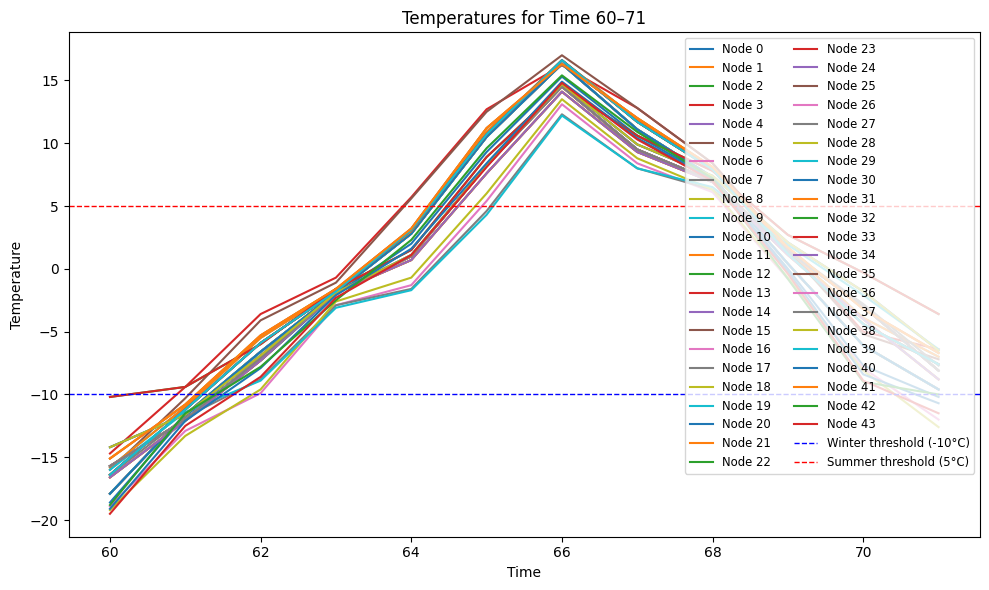

In [ ]:
import matplotlib.pyplot as plt
import math

# Assume all nodes have the same length of temperature data
some_node = next(iter(G_undirected.nodes()))
total_timesteps = len(G_undirected.nodes[some_node]["temperature"])
segment_size = 12
num_segments = math.ceil(total_timesteps / segment_size)

for seg in range(num_segments):
    plt.figure(figsize=(10, 6))
    start = seg * segment_size
    end = (seg + 1) * segment_size

    for i in G_undirected.nodes():
        temp_series = G_undirected.nodes[i]["temperature"][start:end]
        plt.plot(range(start, end), temp_series, label=f"Node {i}")

    # Add horizontal lines for seasonal thresholds
    plt.axhline(
        -10, color="blue", linestyle="--", linewidth=1, label="Winter threshold (-10°C)"
    )
    plt.axhline(
        5, color="red", linestyle="--", linewidth=1, label="Summer threshold (5°C)"
    )

    plt.xlabel("Time")
    plt.ylabel("Temperature")
    plt.title(f"Temperatures for Time {start}–{end - 1}")
    plt.legend(loc="upper right", fontsize="small", ncol=2)
    plt.tight_layout()
    plt.show()


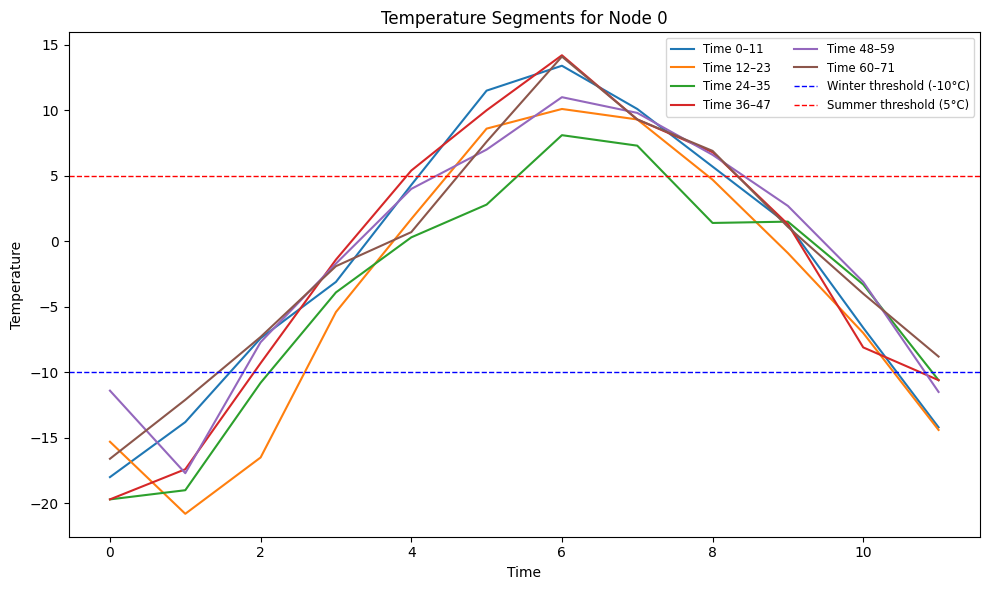

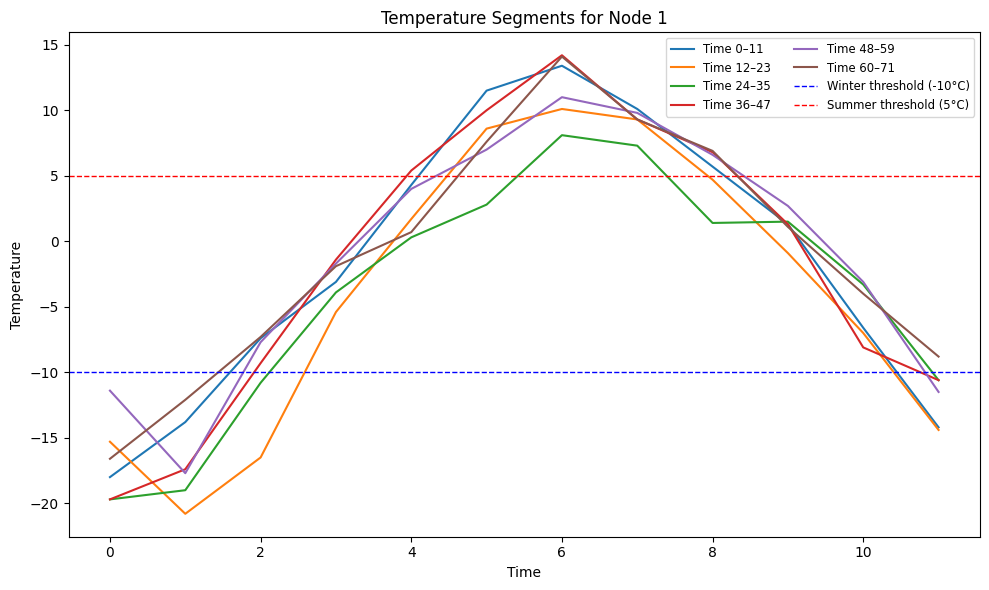

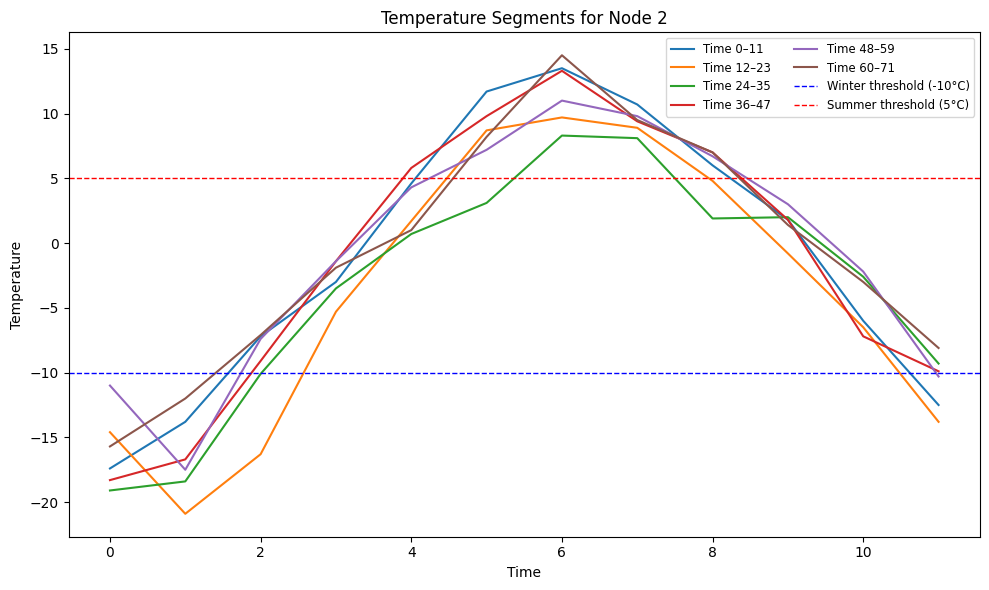

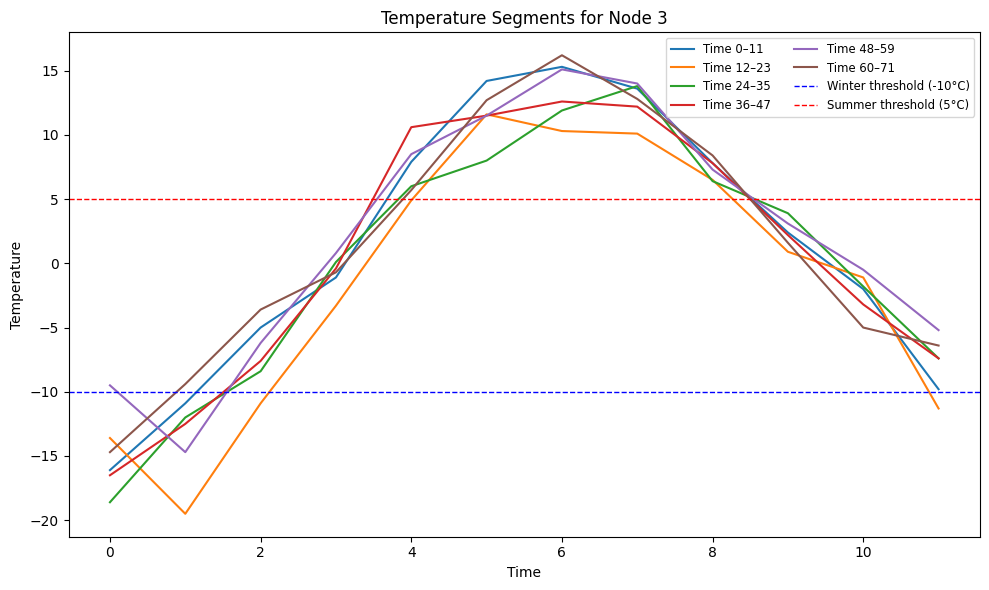

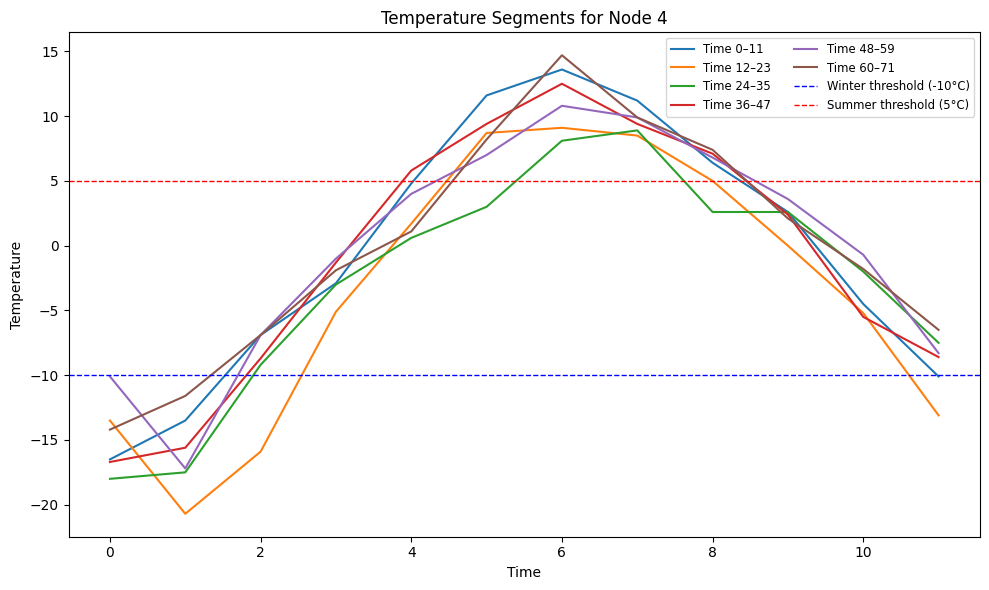

...

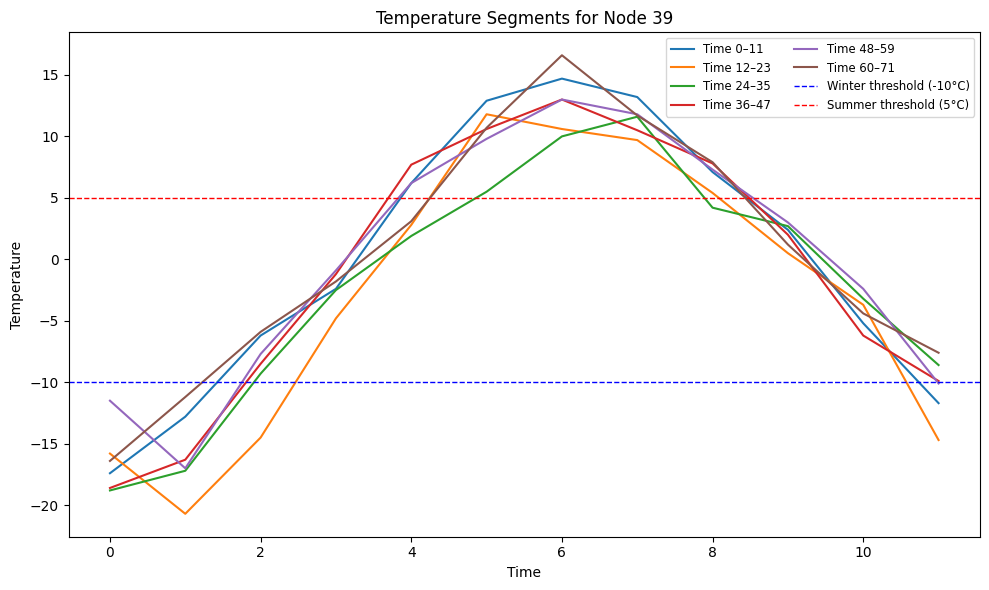

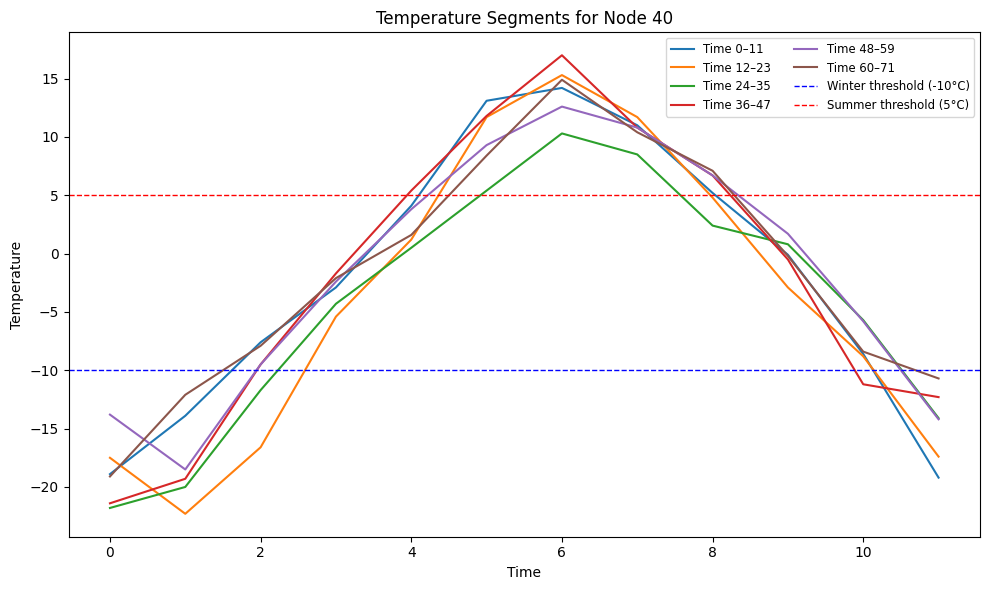

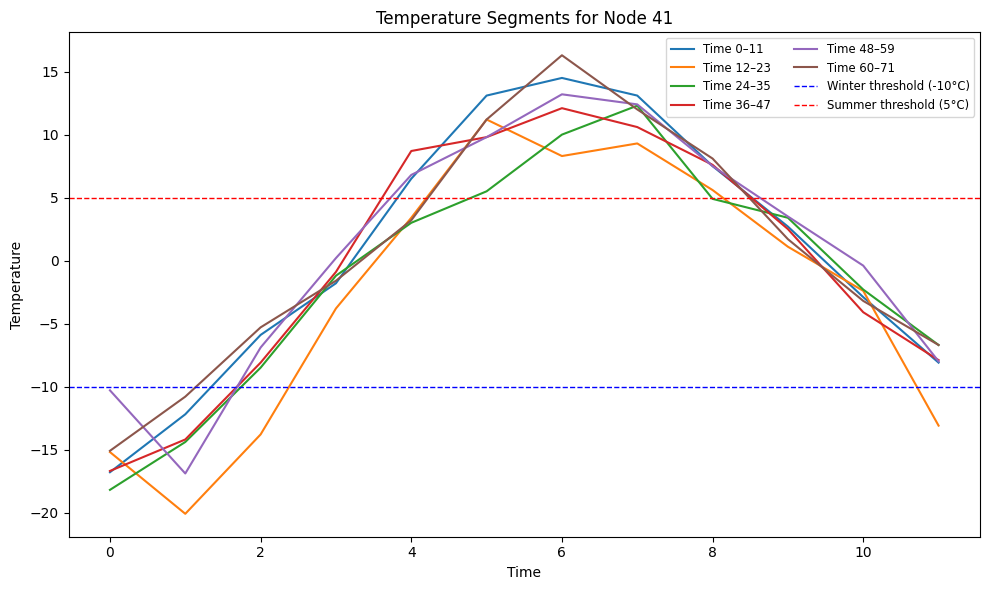

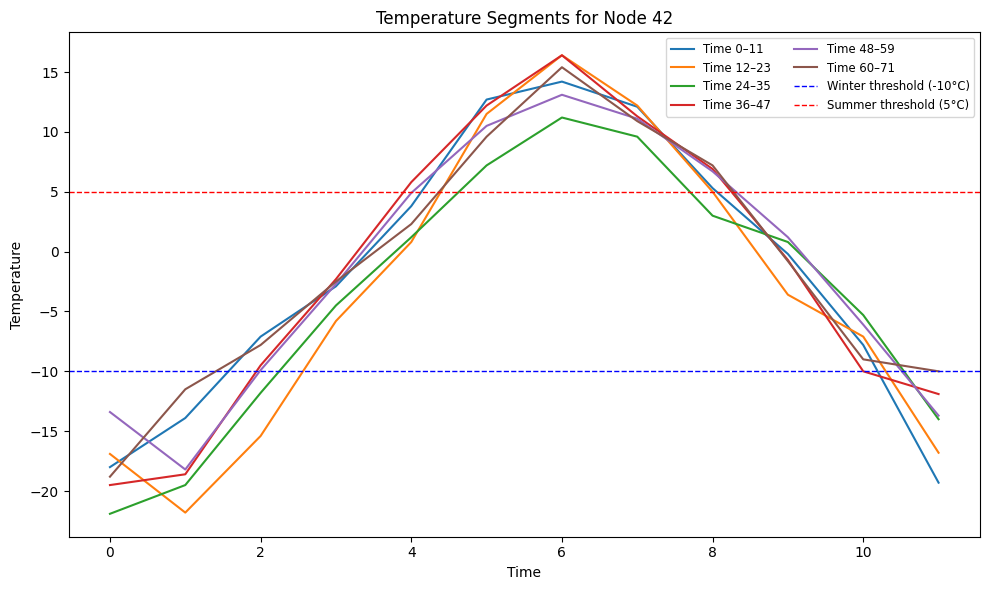

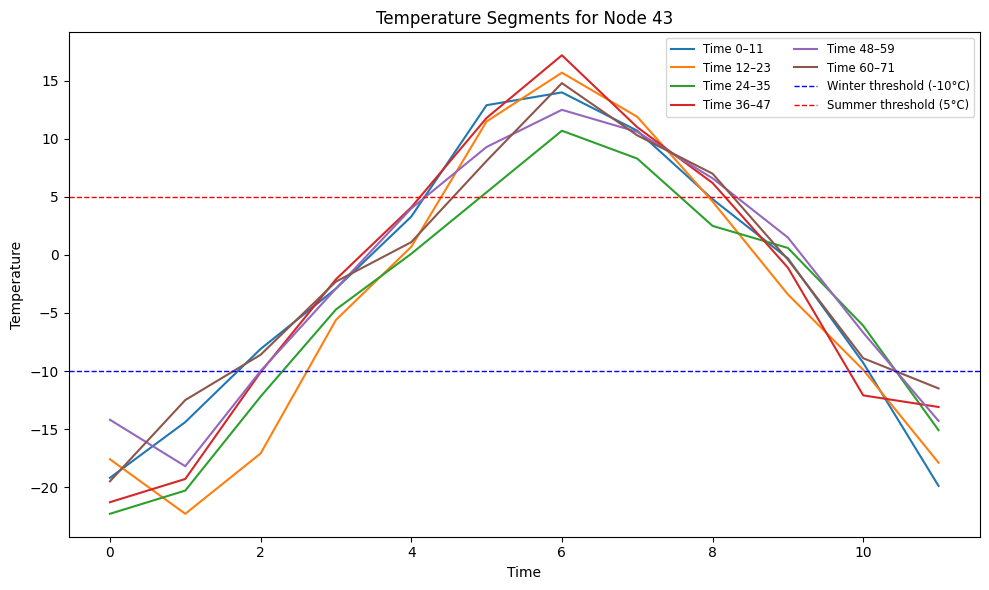

In [ ]:
import matplotlib.pyplot as plt
import math

# Optional: define a color map for seasons
segment_size = 12

for node in G_undirected.nodes():
    temperature = G_undirected.nodes[node]["temperature"]
    total_timesteps = len(temperature)
    num_segments = math.ceil(total_timesteps / segment_size)

    plt.figure(figsize=(10, 6))

    for seg in range(num_segments):
        start = seg * segment_size
        end = min((seg + 1) * segment_size, total_timesteps)
        segment = temperature[start:end].reset_index(drop=True)

        # Shift x-axis to actual time positions
        plt.plot(segment, label=f"Time {start}–{end-1}")

    # Add horizontal lines for seasonal thresholds
    plt.axhline(
        -10, color="blue", linestyle="--", linewidth=1, label="Winter threshold (-10°C)"
    )
    plt.axhline(
        5, color="red", linestyle="--", linewidth=1, label="Summer threshold (5°C)"
    )

    plt.xlabel("Time")
    plt.ylabel("Temperature")
    plt.title(f"Temperature Segments for Node {node}")
    plt.legend(loc="upper right", fontsize="small", ncol=2)
    plt.tight_layout()
    plt.show()


### Мои комменты и мысли по всему происходящему

In [ ]:
"""DONE

NOTE: у каждого города следует указать температуру
тк формально в один момент времени в разных городах могут быть разные сезоны --
-- а это значит что для существования линка нужно чтобы в двух городах был
подходящий для линка сезон
"""


'DONE\n\nNOTE: у каждого города следует указать температуру\nтк формально в один момент времени в разных городах могут быть разные сезоны --\n-- а это значит что для существования линка нужно чтобы в двух городах был\nподходящий для линка сезон\n'

In [ ]:
"""DONE [ну кроме последнего пункта но то такое]

короче NOTE: Для каждого сервиса -- разный граф (!!!)
- не только в формате где сервисы
- но и в формате что для школы условно на самолете нет смысла мб смотреть
а для госпиталя есть
"""


'DONE [ну кроме последнего пункта но то такое]\n\nкороче NOTE: Для каждого сервиса -- разный граф (!!!)\n- не только в формате где сервисы\n- но и в формате что для школы условно на самолете нет смысла мб смотреть\nа для госпиталя есть\n'

In [ ]:
"""DONE

добавить FIXME:
- посмотреть есть ли что-то на стыке статей по типу:
а) поиск кратчайшего пути на вот этих вероятностных сетях
б) что то про ебучие бензовозы (всм агентный подход для покрытия деманда) + под изменением внешней среды


-- NOTE: нихуя там короче нет чисто мб 1-2 статьи в этом направлении но и то специфичные
"""


'DONE\n\nдобавить FIXME:\n- посмотреть есть ли что-то на стыке статей по типу:\nа) поиск кратчайшего пути на вот этих вероятностных сетях\nб) что то про ебучие бензовозы (всм агентный подход для покрытия деманда) + под изменением внешней среды\n\n\n-- NOTE: нихуя там короче нет чисто мб 1-2 статьи в этом направлении но и то специфичные\n'

In [ ]:
"""DONE

TODO: посмотреть шо там вероятностные сети вообще существует((( плак-плак
+ отдельно путь на них

-- NOTE: нихуя там короче нет чисто мб 1-2 статьи в этом направлении но и то специфичные
"""


'DONE\n\nTODO: посмотреть шо там вероятностные сети вообще существует((( плак-плак\n+ отдельно путь на них\n\n-- NOTE: нихуя там короче нет чисто мб 1-2 статьи в этом направлении но и то специфичные\n'

In [ ]:
"""DONE

короче NOTE: Хочется как будто иметь отдельные сущности для каждого вида транспорта,
чтобы задавать параметры отдельно чтоль

-- что-то уже и хз
"""


'DONE\n\nкороче NOTE: Хочется как будто иметь отдельные сущности для каждого вида транспорта,\nчтобы задавать параметры отдельно чтоль\n\n-- что-то уже и хз\n'

In [ ]:
"""DONE

короче NOTE

чтобы считать для разных территоий (всм Арктика / Африка итп) мне нужно глобально:

-  некий объект внешней среды который имеет значения которые влиюят на мой граф
тут что-то про то что если это гдф то ну я как-то пересекаю это с графом
если нет то мне нужен некий маппинг между моим объектом внешней среды и графом

- этот объект глобально изменяет свои параметры со временем.
Считаем что это а) какая-то периодическая функция б) некий глобальный тренд
Может меняться как равнимерно так и <<по участкам>> ака неравномерно влиять на точки

- нормально зайдет если у меня граф дефолтно или с геометриями или нет (!?)
"""


'DONE\n\nкороче NOTE\n\nчтобы считать для разных территоий (всм Арктика / Африка итп) мне нужно глобально:\n\n-  некий объект внешней среды который имеет значения которые влиюят на мой граф\nтут что-то про то что если это гдф то ну я как-то пересекаю это с графом\nесли нет то мне нужен некий маппинг между моим объектом внешней среды и графом\n\n- этот объект глобально изменяет свои параметры со временем.\nСчитаем что это а) какая-то периодическая функция б) некий глобальный тренд\nМожет меняться как равнимерно так и <<по участкам>> ака неравномерно влиять на точки\n\n- нормально зайдет если у меня граф дефолтно или с геометриями или нет (!?)\n'

In [ ]:
"""DONE

короче про граф связей

- я в итоге работаю с вероятностями которые растут или падают от сезона
- скорости как будто тогда нужны для базового расчета обеспеченности (ну доступности)
и тогда я получается имею отдельный какой-то мэтчинг между:
а) ребром & классом ребра & типом ребра и внешней средой
б) то есть для каждого ребра-типа-класса своё правило как оно реагирует на внешнюю среду

и тут уже путь считается как бы сначала по вероятностям каждого ребра в графе:
- нужен некий трэшхолд по которому я говорю что всё нет допустим средняя или минимальная вероятность существования ребра
- и от этого собсно я понимаю есть ли (существует ли) у меня * конкретный * путь или нет
"""


'DONE\n\nкороче про граф связей\n\n- я в итоге работаю с вероятностями которые растут или падают от сезона\n- скорости как будто тогда нужны для базового расчета обеспеченности (ну доступности)\nи тогда я получается имею отдельный какой-то мэтчинг между:\nа) ребром & классом ребра & типом ребра и внешней средой\nб) то есть для каждого ребра-типа-класса своё правило как оно реагирует на внешнюю среду\n\nи тут уже путь считается как бы сначала по вероятностям каждого ребра в графе:\n- нужен некий трэшхолд по которому я говорю что всё нет допустим средняя или минимальная вероятность существования ребра\n- и от этого собсно я понимаю есть ли (существует ли) у меня * конкретный * путь или нет\n'

In [ ]:
"""DONT NEED ANYMORE
Короче вот класс и пример как темпа меняется (ну всм растет) в год
"""

# from copy import deepcopy


# class SeasonByTemperature:
#     def __init__(self, func=None, temp_raise_year=None, step_year=0, total_increment=0):
#         self.func = deepcopy(func)
#         self.temp_raise_year = temp_raise_year
#         self.step_year = step_year
#         self.total_increment = total_increment

#     def incement_temp(self, new_increment: int | None = None):
#         if new_increment:
#             self.temp_raise_year = new_increment
#         if self.temp_raise_year and self.func.any():
#             self.func += self.temp_raise_year
#             self.step_year += 1
#             self.total_increment += self.temp_raise_year
#         else:
#             print("No temperature function or raise year defined.")

#     def get_monthly_temp(self, month_idx: int = None):
#         if month_idx and month_idx in range(1, len(self.func) + 1):
#             return round(self.func[month_idx - 1], 1)
#         else:
#             print("Invalid month index. Must be between 1 and 12.")

#     def get_season_by_temperature(temp):
#         if temp < -10:
#             return "winter"
#         elif temp > 5:
#             return "summer"
#         else:
#             return "midseason"

#     def get_season_by_month(self, month_idx: int = None):
#         return self.get_season_by_temperature(self.get_monthly_temp(month_idx))

#     def __repr__(self):
#         return f"<Year: {self.step_year}, Temp: {self.total_increment:.2f}>"


# temp_env = SeasonByTemperature(
#     func=periodic_temp_func,
#     temp_raise_year=0.5,
# )

# for i in range(12):
#     temp_env.incement_temp()

# print(temp_env, temp_env.get_monthly_temp(12))
# pprint(f"Temperature function: {temp_env.func}")
# pprint(f"Total temperature increment: {temp_env.total_increment}")
# pprint(f"Step year: {temp_env.step_year}")


'DONT NEED ANYMORE\nКороче вот класс и пример как темпа меняется (ну всм растет) в год\n'

In [ ]:
"""НЕ УВЕРЕН ЧТО ЭТО НУЖНО
Но это без каких-либо FACILITIES.

Можно будет добавить потом но хз пока не надо
"""

# class CityNode:
#     def __init__(self, name):
#         self.name = name
#         self.geometry = None
#         self.temperature = None
#         self.season = None

#     def __repr__(self):
#         return f"CityNode(name={self.name})"


'НЕ УВЕРЕН ЧТО ЭТО НУЖНО\nНо это без каких-либо FACILITIES.\n\nМожно будет добавить потом но хз пока не надо\n'